# Lending Tree Loan Status: Upsampling
## Classification - XGBoost HPO RAPIDS GPU

## Set Up Environment, Read Data, Split Train/Validation Sets

In [ ]:
# Upgrade pip
!pip install --upgrade pip

In [ ]:
# Install/import dependencies
!pip install --upgrade -q wandb
!pip install xgboost==1.5.2
!pip install optuna
!pip install dask_optuna
!pip install eli5
!pip install shap
!pip install plotly
import os
import warnings
import random
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask.utils import parse_bytes
from dask_cuda import LocalCUDACluster
import dask_cudf
import dask_optuna
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import cudf
import cuml
from xgboost import XGBClassifier, plot_importance
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import joblib
import pickle
import pandas as pd
import sklearn
from sklearn.metrics import f1_score, roc_auc_score, accuracy_score
from sklearn.metrics import recall_score, precision_score
from sklearn.metrics import classification_report, confusion_matrix
import plotly.offline as py
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
import shap
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
print('\n')
!nvidia-smi



Tue Sep 20 01:29:52 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA RTX A4000    Off  | 00000000:00:05.0 Off |                  Off |
| 41%   33C    P2    37W / 140W |    157MiB / 16376MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----

In [ ]:
# Set up Dask cluster    
cluster = LocalCUDACluster(CUDA_VISIBLE_DEVICES='0', memory_limit='10GB', 
                           device_memory_limit='5GB', ip='0.0.0.0')

client = Client(cluster)
client

distributed.preloading - INFO - Import preload module: dask_cuda.initialize


Connection method: Cluster object,Cluster type: dask_cuda.LocalCUDACluster
Dashboard: http://10.42.102.181:8787/status,
Dashboard: http://10.42.102.181:8787/status,Workers: 1
Total threads: 1,Total memory: 9.31 GiB
Status: running,Using processes: True
Comm: tcp://10.42.102.181:40087,Workers: 1
Dashboard: http://10.42.102.181:8787/status,Total threads: 1
Started: Just now,Total memory: 9.31 GiB
Comm: tcp://10.42.102.181:34261,Total threads: 1
Dashboard: http://10.42.102.181:38723/status,Memory: 9.31 GiB
Nanny: tcp://10.42.102.181:40241,


In [ ]:
# Define function to time code blocks
@contextmanager
def timed(name):
    t0 = time.time()
    yield
    t1 = time.time()
    print('..%-24s:  %8.4f' % (name, t1 - t0))

In [ ]:
# Set seed 
seed_value = 42
os.environ['xgbRAPIDS_GPU'] = str(seed_value)
random.seed(seed_value)
cupy.random.seed(seed_value)
np.random.seed(seed_value)

In [ ]:
%cd /notebooks/LoanStatus/Data/

/notebooks/LoanStatus/Data


In [ ]:
# Read data
trainDF = cudf.read_csv('trainDF_US.csv', low_memory=False)
print('Train set: Number of rows and columns:', trainDF.shape)

testDF = cudf.read_csv('testDF_US.csv', low_memory=False)
print('Test set: Number of rows and columns:', testDF.shape)

Train set: Number of rows and columns: (3022132, 51)
Test set: Number of rows and columns: (432473, 51)


In [ ]:
# Split train set into train and validation set
X_train, X_val, y_train, y_val = train_test_split(trainDF, 'loan_status', 
                                                  train_size=0.8)

# Convert data types for modeling
X_train = X_train.astype('float32')
y_train = y_train.astype('int32')
X_val = X_val.astype('float32')
y_val = y_val.astype('int32')

## Weighted F1

### 100 Trials

# Find correct name

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL/

# Define a name for the trials
study_name = 'dask_optuna_us_xgbRapids_weightedF1_100_tpe'

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_us_xgb100gpu_trainvaltest', 
                'save_code': 'False', 'notes': 'xgb100gpu_trainvaltest'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 

    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'xgbRAPIDS_Optuna_US_100_GPU_f1weighted.pkl')

    # Define parameter grid
    params_xgboost_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'subsample': trial.suggest_float('subsample', 0.25, 0.75),
        'gamma': trial.suggest_float('gamma', 0, 3),
        'learning_rate': trial.suggest_float('learning_rate', 1e-4, 0.3),
        'reg_alpha': trial.suggest_float('reg_alpha', 0, 3),
        'reg_lambda': trial.suggest_float('reg_lambda', 0, 3),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.99),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.05, 0.5), 
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 10)
        }    

    # Define model type
    xgb = XGBClassifier(objective='binary:logistic',
                        booster='gbtree',
                        tree_method='gpu_hist',
                        scale_pos_weight=1,
                        use_label_encoder=False,
                        random_state=seed_value,
                        verbosity=0,
                        **params_xgboost_optuna)
    
    # Start timer for each trial
    start = timer()

    # Fit model
    xgb.fit(X_train, y_train, 
            eval_set=[(X_val, y_val)], 
            verbose=0)      
    
    # Predictions
    y_pred_val = xgb.predict(X_val)
    score = f1_score(asnumpy(y_val), asnumpy(y_pred_val), average='weighted')
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial weighted F1:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('xgbRAPIDS_Optuna_US_100_GPU_f1weighted.pkl'): 
        study = joblib.load('xgbRAPIDS_Optuna_US_100_GPU_f1weighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial), 
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 3.583787319017574
- Trial weighted F1: 0.9562076605164931
######################################################
- Trial time: 4.961999525083229
- Trial weighted F1: 0.9566825038757134
######################################################
- Trial time: 11.933456601109356
- Trial weighted F1: 0.9790955045970264
######################################################
- Trial time: 9.918549810070544
- Trial weighted F1: 0.9610626453014111
######################################################
- Trial time: 2.7488101650960743
- Trial weighted F1: 0.9327759203510303
######################################################
- Trial time: 8.384006108855829
- Trial weighted F1: 0.9619366084938928
######################################################
- Trial time: 12.282639890210703
- Trial weighted F1: 0.9577984055686536
######################################################
- Trial time: 5.418138577137142
- Trial weighted F1: 0.9660003652610533
####################################

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/trialOptions/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'f1_weighted'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('f1_weighted', ascending=False)
trials_df.to_csv('xgbRAPIDS_Optuna_US_100_GPU_f1weighted.csv', index=False)
print(trials_df) 

    iteration  f1_weighted             datetime_start  \
83         83     0.998610 2022-09-17 00:15:23.955670   
93         93     0.998514 2022-09-17 00:19:03.761764   
92         92     0.998478 2022-09-17 00:18:36.839231   
51         51     0.998471 2022-09-17 00:03:48.600152   
91         91     0.998446 2022-09-17 00:18:09.694712   
..        ...          ...                        ...   
9           9     0.955206 2022-09-16 23:51:10.871441   
36         36     0.943056 2022-09-16 23:59:12.852570   
4           4     0.932776 2022-09-16 23:50:34.816546   
8           8     0.931581 2022-09-16 23:51:04.930855   
99         99          NaN 2022-09-17 00:21:23.378538   

            datetime_complete               duration  colsample_bylevel  \
83 2022-09-17 00:15:51.090744 0 days 00:00:27.135074           0.434451   
93 2022-09-17 00:19:30.750185 0 days 00:00:26.988421           0.416104   
92 2022-09-17 00:19:03.761302 0 days 00:00:26.922071           0.434573   
51 2022-09-17 0

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_xgbRAPIDS_Optuna_US_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_xgbRAPIDS_Optuna_US_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_xgbRAPIDS_Optuna_US_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'learning_rate', 
                                                       'gamma'])
py.plot(fig, filename='contour_xgbRAPIDS_Optuna_US_100_GPU_f1weighted.html')
fig.show()

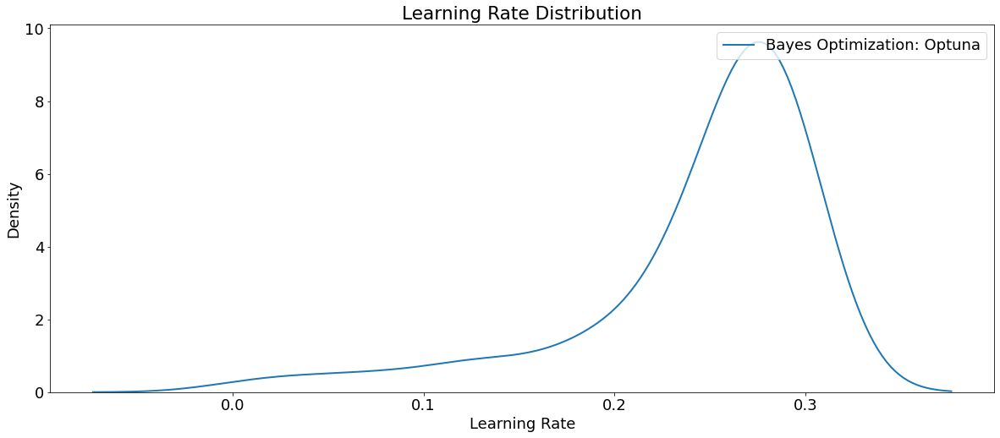

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

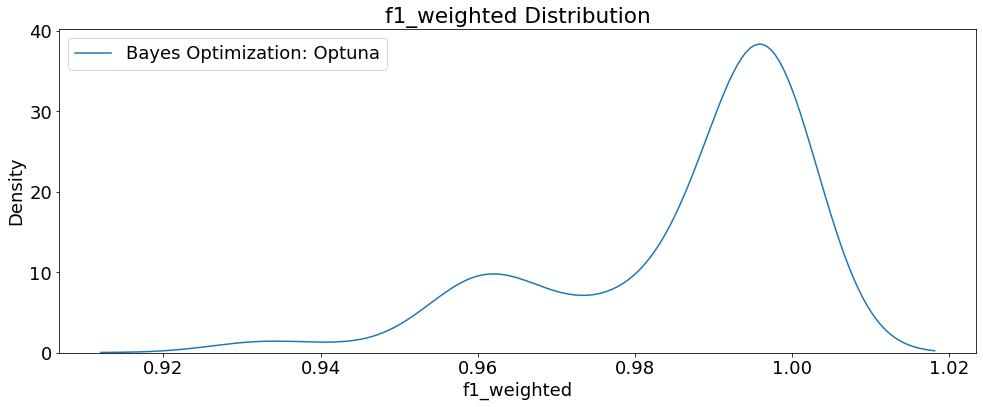

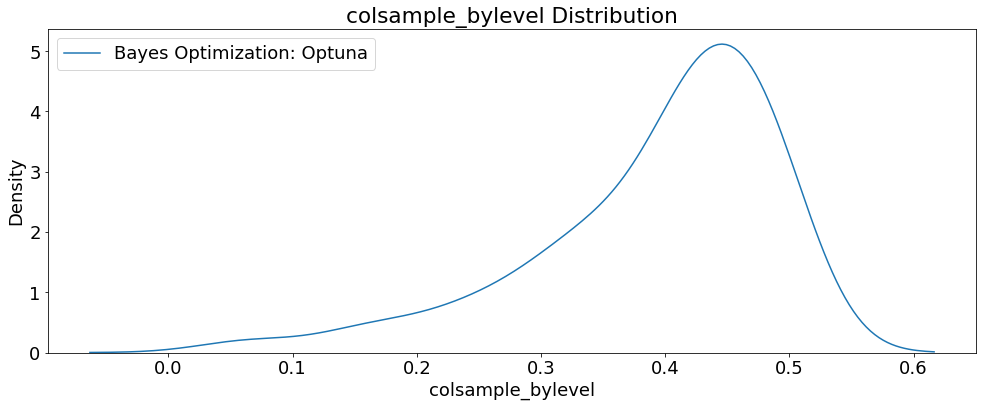

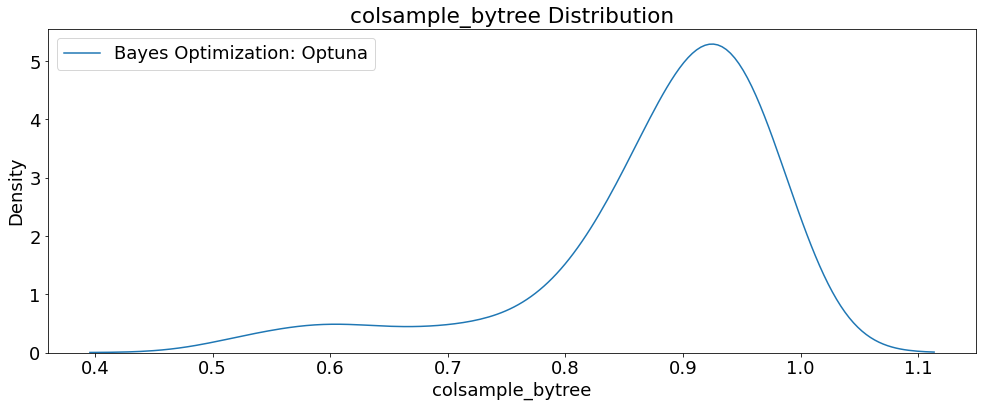

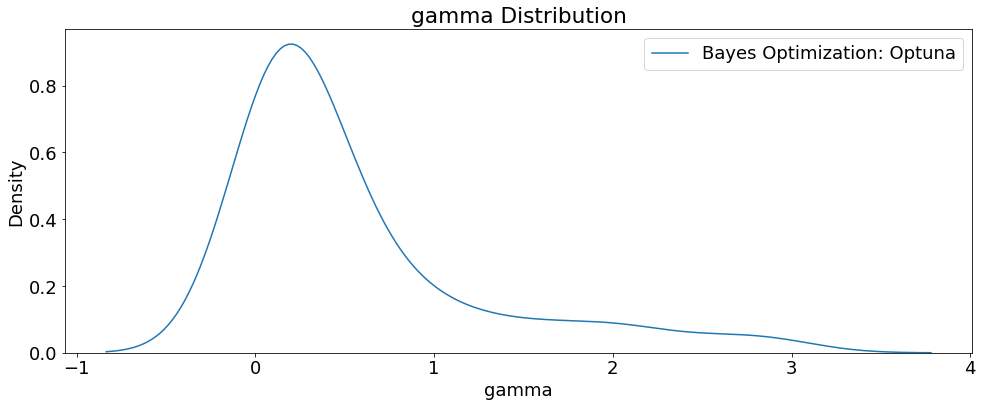

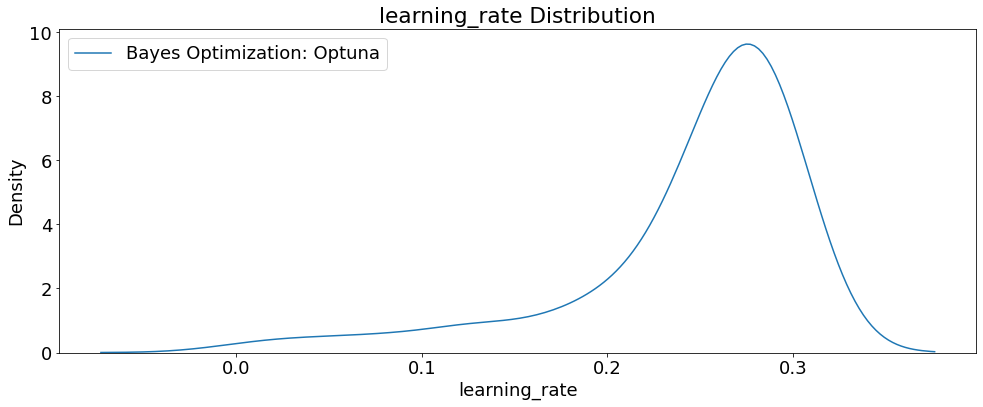

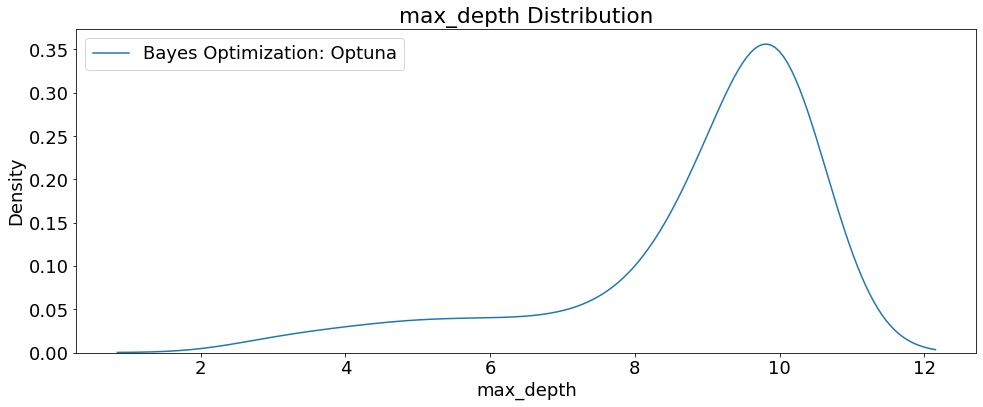

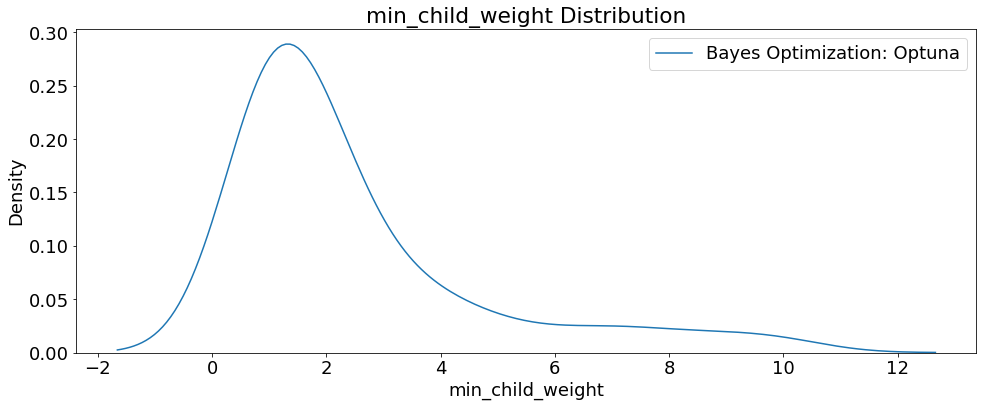

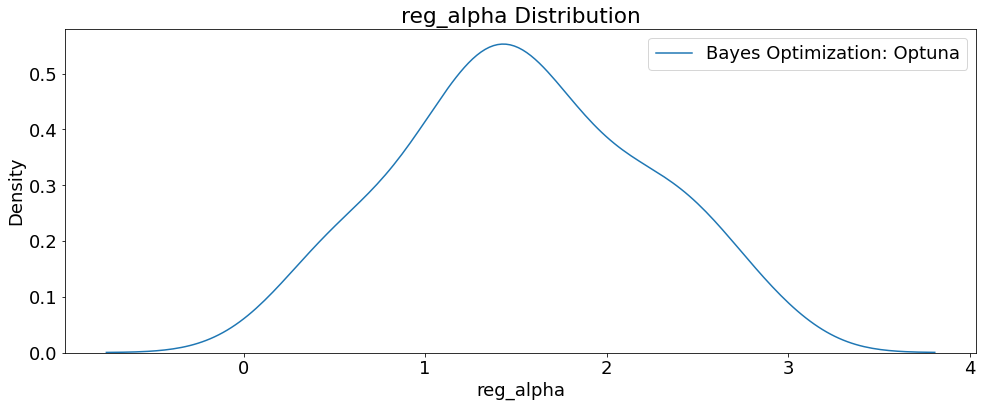

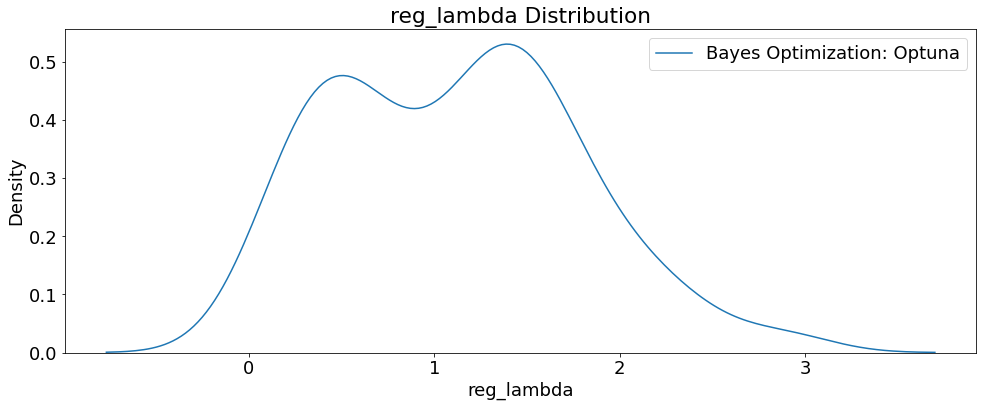

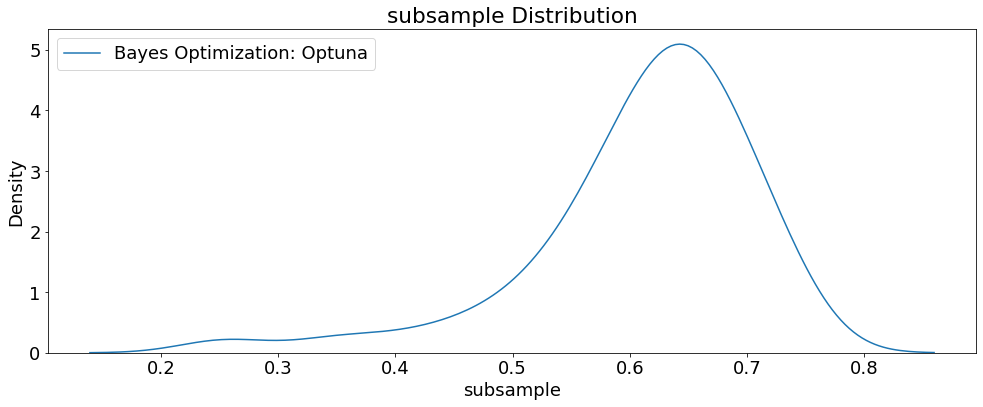

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

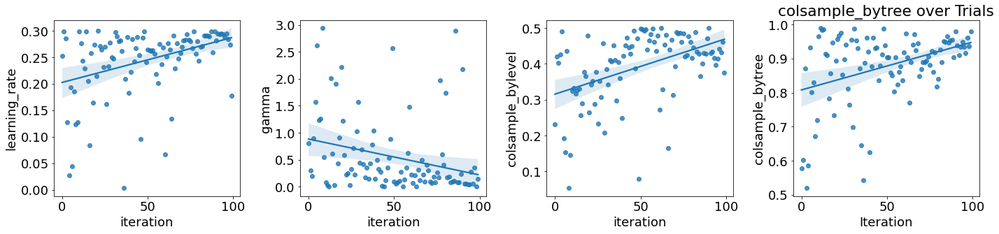

In [ ]:
# Plot quantitative hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'gamma', 'colsample_bylevel',
                         'colsample_bytree']): 
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

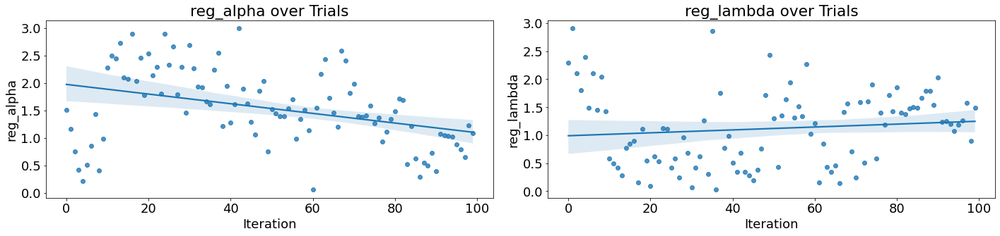

In [ ]:
# Scatterplot of regularization hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20, 5))
i = 0
for i, hpo in enumerate(['reg_alpha', 'reg_lambda']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_xgbRAPIDS_Optuna_US_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_xgbRAPIDS_Optuna_US_100_GPU_f1weighted.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params

{'n_estimators': 492,
 'max_depth': 10,
 'subsample': 0.6567307712043776,
 'gamma': 0.08275055914474287,
 'learning_rate': 0.2912951757397749,
 'reg_alpha': 0.527734348601889,
 'reg_lambda': 1.480131608604455,
 'colsample_bytree': 0.9511431466512609,
 'colsample_bylevel': 0.43445110708689855,
 'min_child_weight': 1}

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_train = X_train.astype('float32')

X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = XGBClassifier(objective='binary:logistic', 
                           booster='gbtree',
                           tree_method='gpu_hist',
                           scale_pos_weight=1,
                           use_label_encoder=False,
                           random_state=seed_value,
                           verbosity=0,
                           **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'xgbRAPIDS_Optuna_US_100trials_GPU_f1weighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('xgbRAPIDS_Optuna_US_100trials_GPU_f1weighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost RAPIDS HPO Upsampling 100 trials GPU F1 Weighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)
print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f' % accuracy_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Precision score : %.3f' % precision_score(asnumpy(y_test), 
                                                 asnumpy(y_test_pred)))
print('Recall score : %.3f' % recall_score(asnumpy(y_test), 
                                           asnumpy(y_test_pred)))
print('F1 score : %.3f' % f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for XGBoost RAPIDS HPO Upsampling 100 trials GPU F1 Weighted


Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    377848
           1       0.99      0.92      0.95     54625

    accuracy                           0.99    432473
   macro avg       0.99      0.96      0.97    432473
weighted avg       0.99      0.99      0.99    432473



Confusion matrix:
[[377254    594]
 [  4630  49995]]


Accuracy score : 0.988
Precision score : 0.988
Recall score : 0.915
F1 score : 0.950


In [ ]:
# Evaluate on the testing data 
print('The best model from Upsampling 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                               asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from Upsampling 100 GPU trials optimization scores 0.95683 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    83
f1_weighted                             0.99861
datetime_start       2022-09-17 00:15:23.955670
datetime_complete    2022-09-17 00:15:51.090744
duration                 0 days 00:00:27.135074
colsample_bylevel                      0.434451
colsample_bytree                       0.951143
gamma                                  0.082751
learning_rate                          0.291295
max_depth                                    10
min_child_weight                              1
n_estimators                                492
reg_alpha                              0.527734
reg_lambda                             1.480132
subsample                              0.656731
state                                  COMPLETE
Name: 83, dtype: object


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(asnumpy(X_test), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/xgbRAPIDS_Optuna_US_100_GPU_f1weighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/xgbRAPIDS_Optuna_US_100_GPU_f1weighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.2712 ± 0.0005,total_pymnt
0.2398 ± 0.0010,out_prncp
0.0813 ± 0.0007,installment
0.0808 ± 0.0008,loan_amnt
0.0671 ± 0.0002,recoveries
0.0399 ± 0.0004,last_pymnt_amnt
0.0215 ± 0.0003,total_rec_int
0.0042 ± 0.0003,int_rate
0.0014 ± 0.0001,total_rec_late_fee
0.0004 ± 0.0001,term_ 60 months


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_test.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('xgbRAPIDS_Optuna_US_100_GPU_f1weighted_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,total_pymnt,0.271161,0.000252
1,out_prncp,0.239773,0.000492
2,installment,0.081312,0.000372
3,loan_amnt,0.080751,0.000376
4,recoveries,0.067091,0.000092
5,last_pymnt_amnt,0.039886,0.000178
6,total_rec_int,0.021539,0.000158
7,int_rate,0.004199,0.000158
8,total_rec_late_fee,0.001372,0.000062
9,term_ 60 months,0.000372,0.000041


In [ ]:
# Training Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_train)

<Figure size 432x288 with 0 Axes>

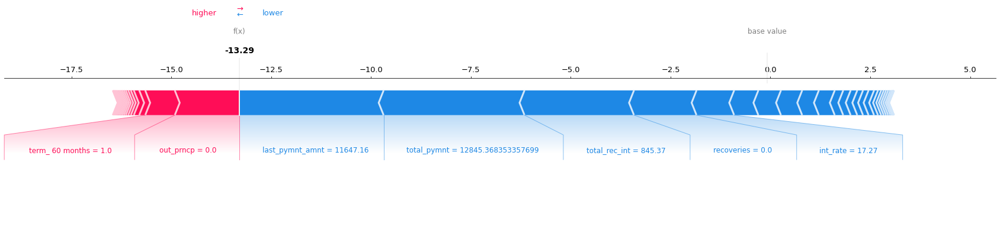

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], 
                X_train.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30,5)).savefig('xgbRAPIDS_Optuna_US_100_GPU_f1weighted_ShapForcePlot_TrainSet.png', 
                                                                     my_dpi=my_dpi*10, 
                                                                     bbox_inches='tight');

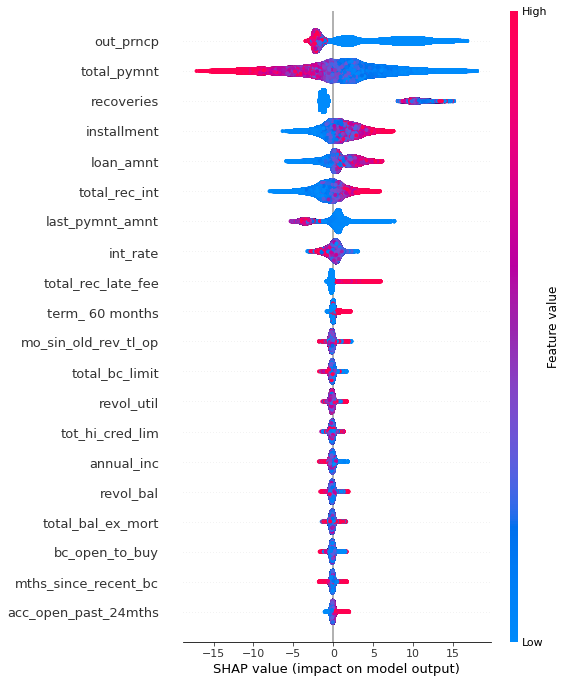

In [ ]:
# Training Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_train.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_US_100_GPU_f1weighted_ShapSummary_TrainSet.png', 
            my_dpi=my_dpi*10, bbox_inches='tight');

In [ ]:
# Test Set: Feature Importance Computed with SHAP Values
shap.initjs()
shap_values = explainer.shap_values(X_test)

<Figure size 432x288 with 0 Axes>

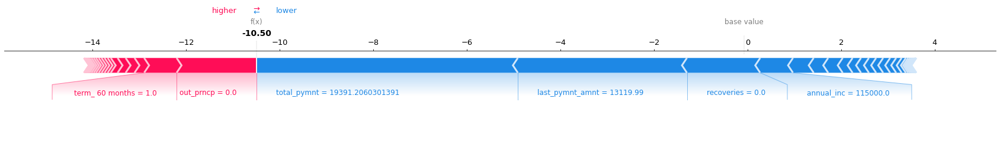

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30,3)).savefig('xgbRAPIDS_Optuna_US_100_GPU_f1weighted_ShapForcePlot_TestSet.png', 
                                                                     my_dpi=my_dpi*10, 
                                                                     bbox_inches='tight');

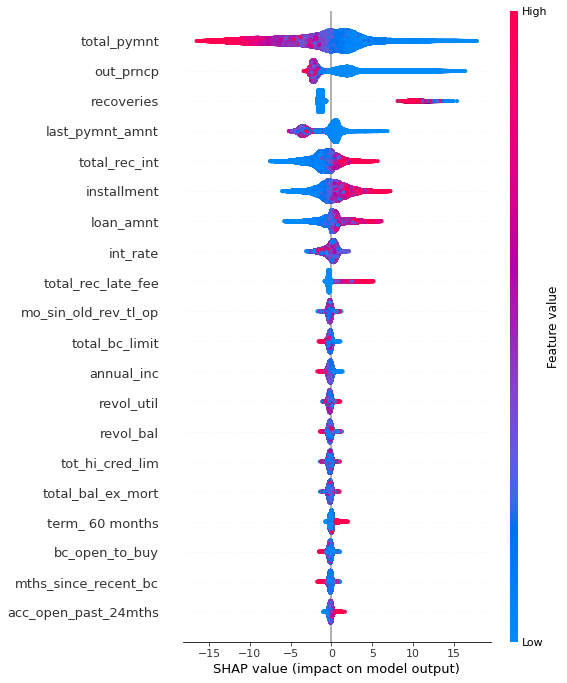

In [ ]:
# Test Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_test.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_US_100_GPU_f1weighted_ShapSummary_TestSet.png', 
            my_dpi=my_dpi*10, bbox_inches='tight');

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

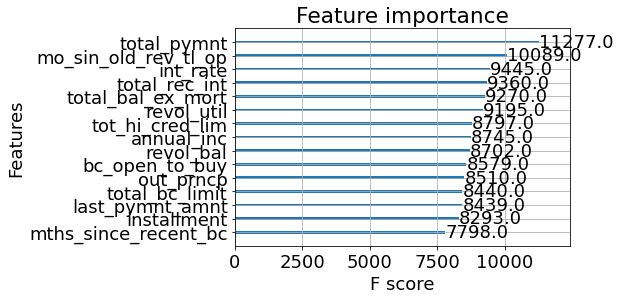

In [ ]:
# Feature importance
plot_importance(best_model, max_num_features=15)

<Figure size 432x288 with 0 Axes>

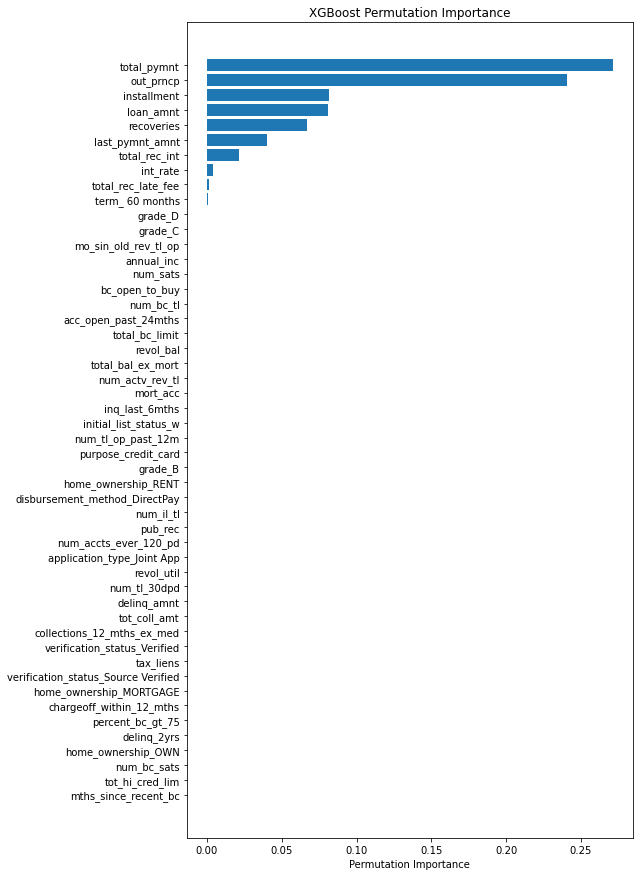

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()
plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('XGBoost Permutation Importance')
fig.savefig('xgbRAPIDS_Optuna_US_100_GPU_f1weighted_permImportance.png', 
            my_dpi=my_dpi*10, bbox_inches='tight')

### 300 Trials

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL/

# Define a name for the trials
study_name = 'dask_optuna_us_xgbRapids_weightedF1_300_tpe'

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_us_xgb300gpu_trainvaltest_f1weighted', 
                'save_code': 'False', 'notes': 'us_xgb300gpu_trainvaltest_f1weighted'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: WARNING Calling wandb.login() after wandb.init() has no effect.


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 

    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'xgbRAPIDS_Optuna_US_300_GPU_f1weighted.pkl')

    # Define parameter grid
    params_xgboost_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 400, 700),
        'max_depth': trial.suggest_int('max_depth', 8, 15),
        'subsample': trial.suggest_float('subsample', 0.6, 0.9),
        'gamma': trial.suggest_float('gamma', 0.02, 1),
        'learning_rate': trial.suggest_float('learning_rate', 0.13, 0.3),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.5, 2.5),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.3, 2),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.8, 0.99),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.25, 0.6), 
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 5)
        }    

    # Define model type
    xgb = XGBClassifier(objective='binary:logistic',
                        booster='gbtree',
                        tree_method='gpu_hist',
                        scale_pos_weight=1,
                        use_label_encoder=False,
                        random_state=seed_value,
                        verbosity=0,
                        **params_xgboost_optuna)
    
    # Start timer for each trial
    start = timer()

    # Fit model
    xgb.fit(X_train, y_train, 
            eval_set=[(X_val, y_val)], 
            verbose=0)    
    
    # Predictions
    y_pred_val = xgb.predict(X_val)
    score = f1_score(asnumpy(y_val), asnumpy(y_pred_val), average='weighted')
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial weighted F1:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('xgbRAPIDS_Optuna_US_300_GPU_f1weighted.pkl'): 
        study = joblib.load('xgbRAPIDS_Optuna_US_300_GPU_f1weighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial),
                       n_trials=300)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest F1 Score', study.best_value)
wandb.finish()

- Trial time: 21.790291022974998
- Trial weighted F1: 0.9959978573284838
######################################################
- Trial time: 25.772715125931427
- Trial weighted F1: 0.9959234048451335
######################################################
- Trial time: 21.66396560589783
- Trial weighted F1: 0.9957943539944408
######################################################
- Trial time: 18.481024460168555
- Trial weighted F1: 0.9893662547768228
######################################################
- Trial time: 30.07565875700675
- Trial weighted F1: 0.9983074877133078
######################################################
- Trial time: 39.55349220102653
- Trial weighted F1: 0.9985937088593406
######################################################
- Trial time: 19.580044443020597
- Trial weighted F1: 0.9943235185266596
######################################################
- Trial time: 24.56792811001651
- Trial weighted F1: 0.9952185812408443
###################################

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/trialOptions/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'f1_weighted'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('f1_weighted', ascending=False)
trials_df.to_csv('xgbRAPIDS_Optuna_US_300_GPU_f1weighted.csv', index=False)
print(trials_df) 

     iteration  f1_weighted             datetime_start  \
191        191     0.999247 2022-09-17 23:42:18.359414   
258        258     0.999242 2022-09-18 00:45:11.098517   
242        242     0.999237 2022-09-18 00:28:52.299674   
197        197     0.999236 2022-09-17 23:47:29.801421   
278        278     0.999231 2022-09-18 01:04:14.356666   
..         ...          ...                        ...   
148        148     0.990621 2022-09-17 23:07:45.365055   
3            3     0.989366 2022-09-17 21:32:25.410750   
287        287     0.988660 2022-09-18 01:12:22.001476   
95          95     0.983905 2022-09-17 22:29:08.662198   
260        260     0.979139 2022-09-18 00:47:19.155823   

             datetime_complete               duration  colsample_bylevel  \
191 2022-09-17 23:43:16.500515 0 days 00:00:58.141101           0.577444   
258 2022-09-18 00:46:14.684968 0 days 00:01:03.586451           0.488759   
242 2022-09-18 00:29:56.528316 0 days 00:01:04.228642           0.518016   

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_xgbRAPIDS_Optuna_US_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_xgbRAPIDS_Optuna_US_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_xgbRAPIDS_Optuna_US_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'learning_rate', 
                                                       'gamma'])
py.plot(fig, filename='contour_xgbRAPIDS_Optuna_US_300_GPU_f1weighted.html')
fig.show()

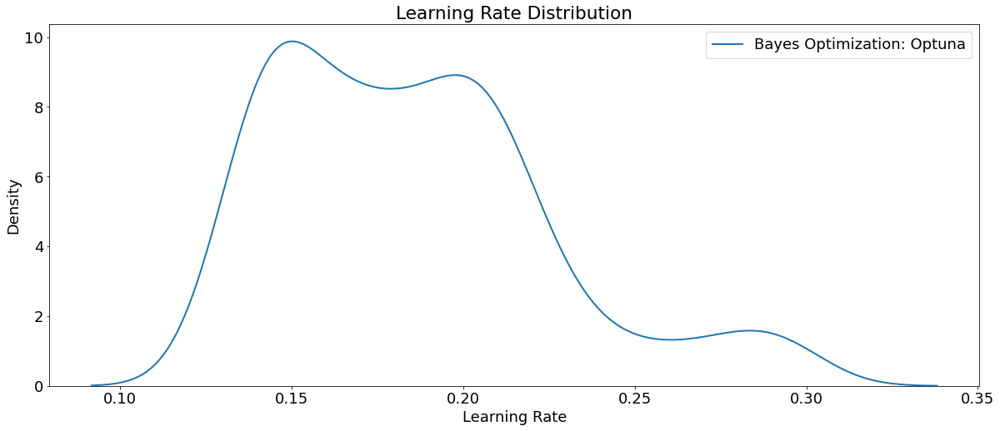

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

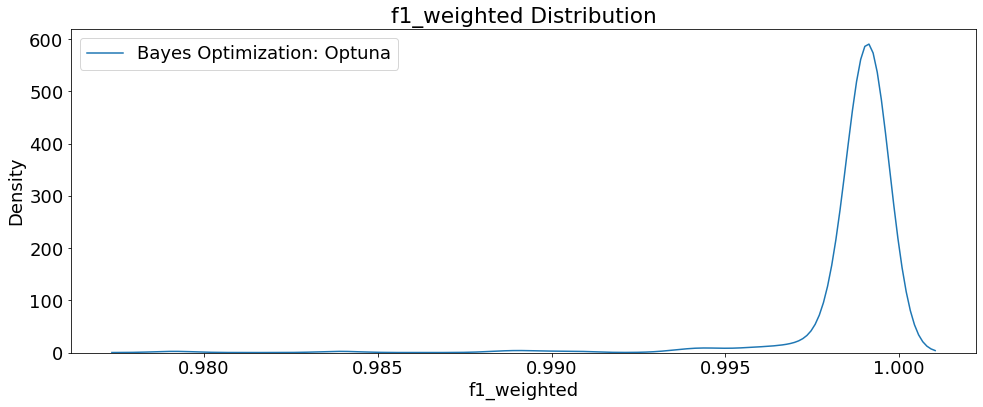

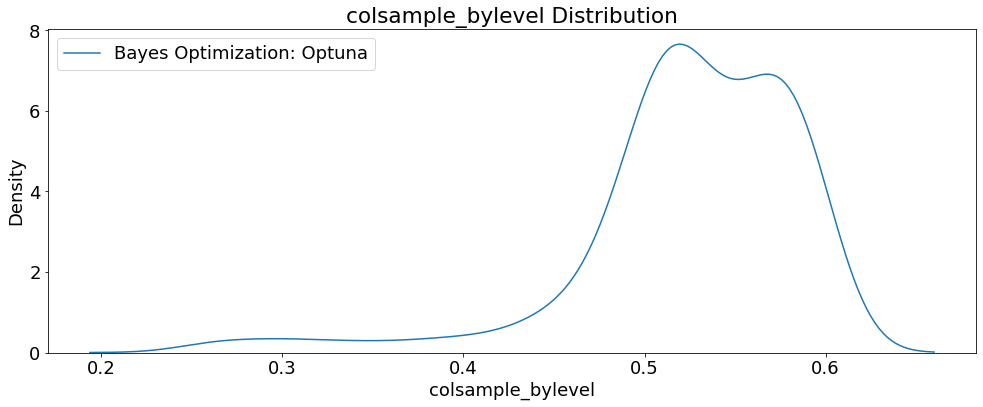

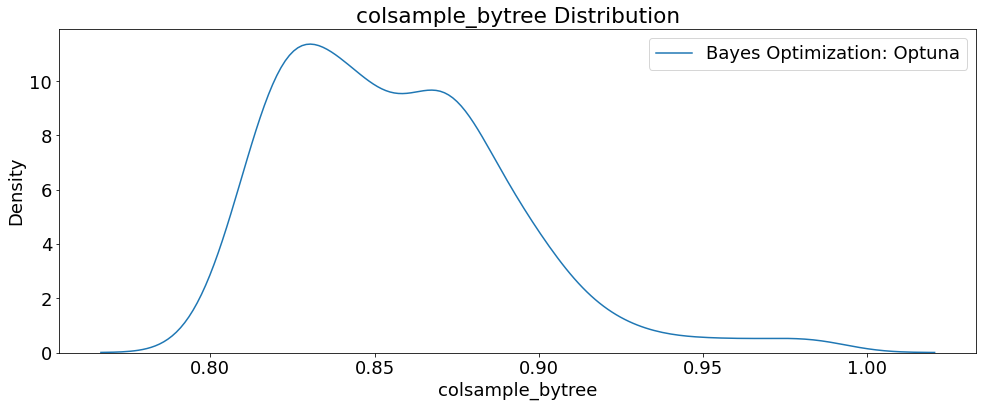

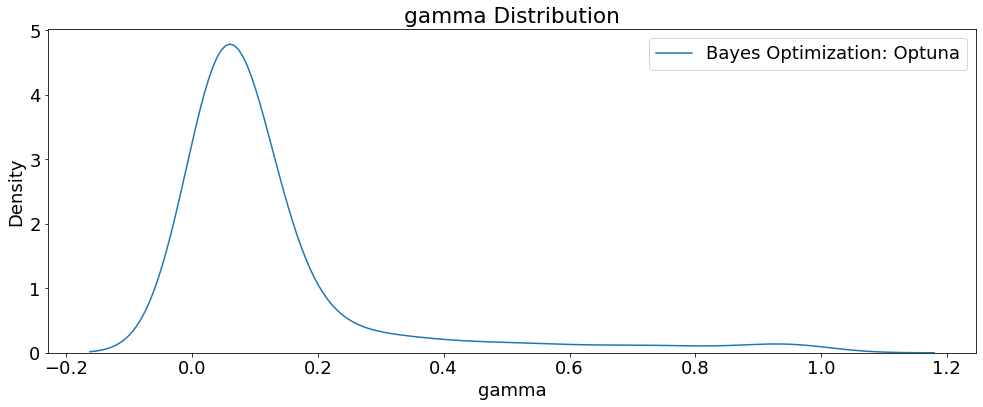

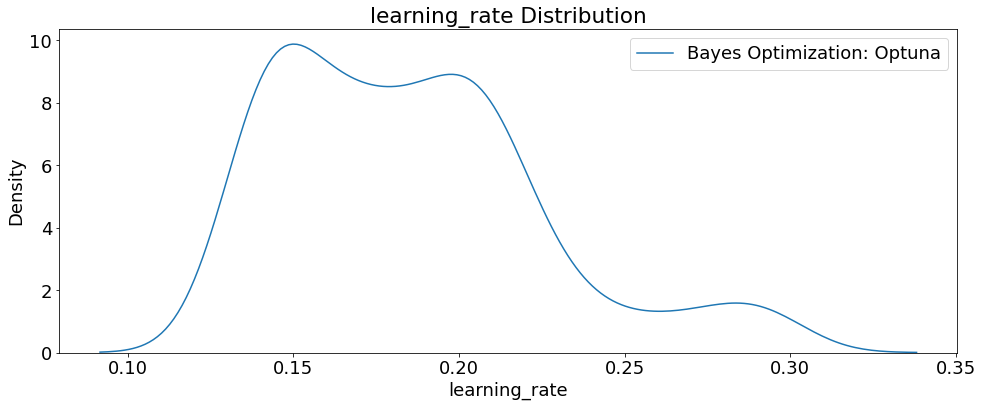

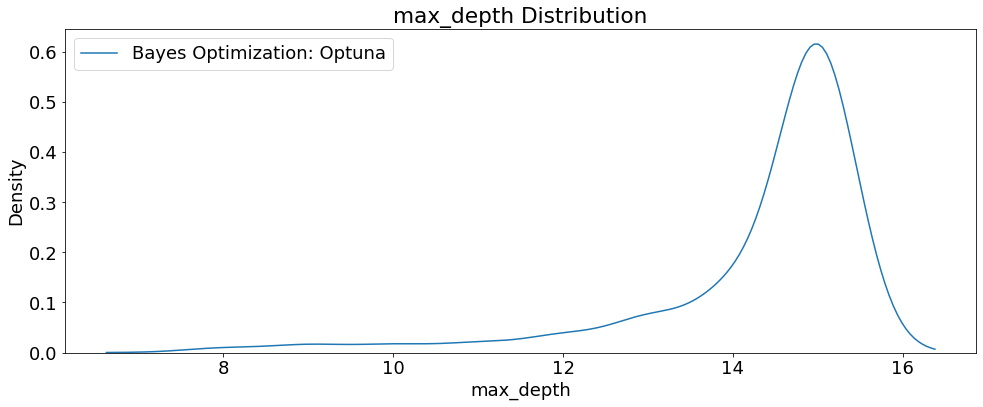

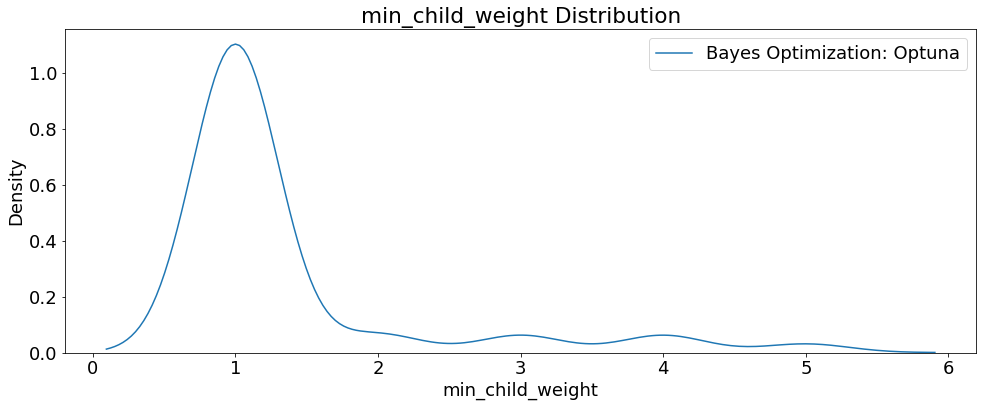

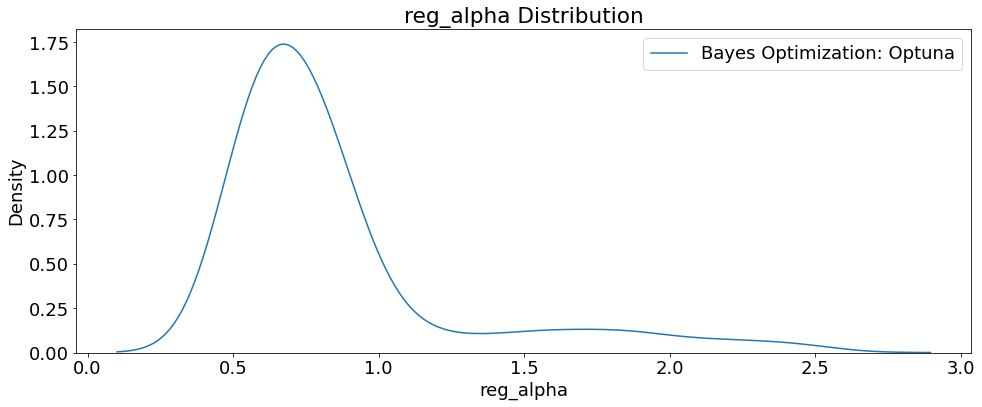

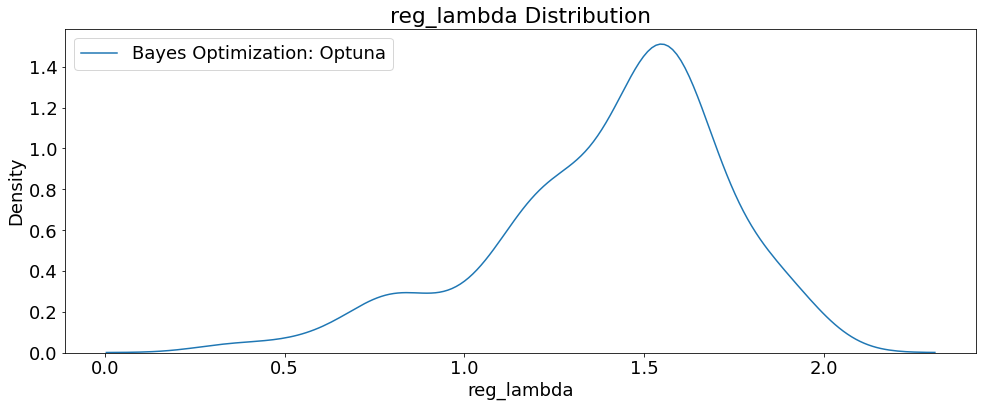

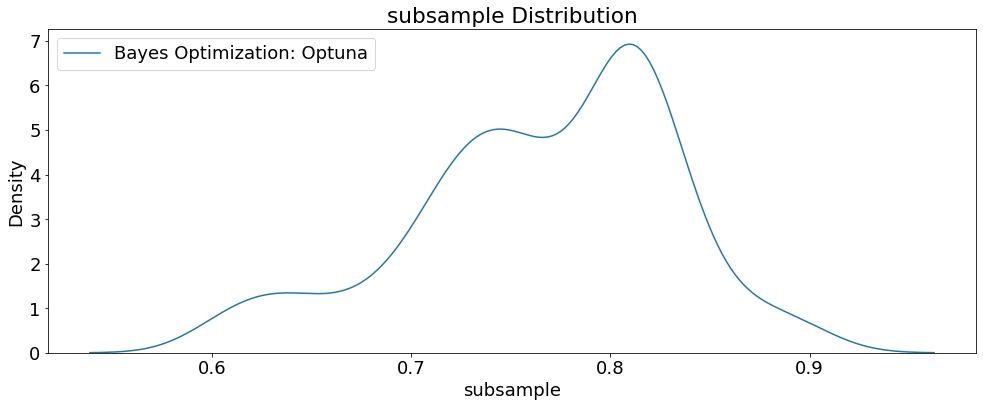

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

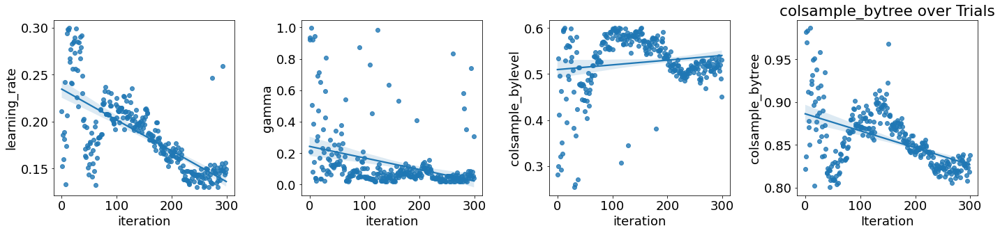

In [ ]:
# Plot quantitative hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'gamma', 'colsample_bylevel',
                         'colsample_bytree']): 
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

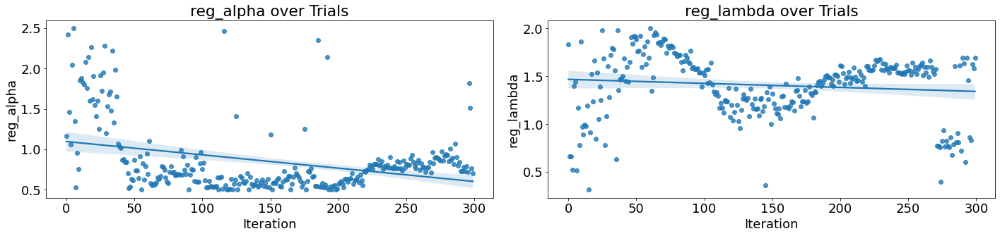

In [ ]:
# Scatterplot of regularization hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['reg_alpha', 'reg_lambda']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_xgbRAPIDS_Optuna_US_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_xgbRAPIDS_Optuna_US_300_GPU_f1weighted.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params

{'n_estimators': 491,
 'max_depth': 15,
 'subsample': 0.7604888319527146,
 'gamma': 0.04087059120394826,
 'learning_rate': 0.15906588784061876,
 'reg_alpha': 0.5297264561831198,
 'reg_lambda': 1.4839744523445213,
 'colsample_bytree': 0.8416926592684433,
 'colsample_bylevel': 0.5774439932010007,
 'min_child_weight': 1}

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_train = X_train.astype('float32')

X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = XGBClassifier(objective='binary:logistic', 
                           booster='gbtree',
                           tree_method='gpu_hist',
                           scale_pos_weight=1,
                           use_label_encoder=False,
                           random_state=seed_value,
                           verbosity=0,
                           **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'xgbRAPIDS_Optuna_US_300trials_GPU_f1weighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('xgbRAPIDS_Optuna_US_300trials_GPU_f1weighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost RAPIDS HPO Upsampling 300 trials GPU F1 Weighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)
print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f' % accuracy_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Precision score : %.3f' % precision_score(asnumpy(y_test), 
                                                 asnumpy(y_test_pred)))
print('Recall score : %.3f' % recall_score(asnumpy(y_test), 
                                           asnumpy(y_test_pred)))
print('F1 score : %.3f' % f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for XGBoost RAPIDS HPO Upsampling 300 trials GPU F1 Weighted


Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    377848
           1       0.99      0.91      0.95     54625

    accuracy                           0.99    432473
   macro avg       0.99      0.96      0.97    432473
weighted avg       0.99      0.99      0.99    432473



Confusion matrix:
[[377480    368]
 [  4727  49898]]


Accuracy score : 0.988
Precision score : 0.993
Recall score : 0.913
F1 score : 0.951


In [ ]:
# Evaluate on the testing data 
print('The best model from Upsampling 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                               asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from Upsampling 300 GPU trials optimization scores 0.95625 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                   191
f1_weighted                            0.999247
datetime_start       2022-09-17 23:42:18.359414
datetime_complete    2022-09-17 23:43:16.500515
duration                 0 days 00:00:58.141101
colsample_bylevel                      0.577444
colsample_bytree                       0.841693
gamma                                  0.040871
learning_rate                          0.159066
max_depth                                    15
min_child_weight                              1
n_estimators                                491
reg_alpha                              0.529726
reg_lambda                             1.483974
subsample                              0.760489
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(asnumpy(X_test), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/xgbRAPIDS_Optuna_US_300_GPU_f1weighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/xgbRAPIDS_Optuna_US_300_GPU_f1weighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.2415 ± 0.0011,out_prncp
0.2346 ± 0.0005,total_pymnt
0.0670 ± 0.0002,recoveries
0.0537 ± 0.0004,loan_amnt
0.0421 ± 0.0002,installment
0.0276 ± 0.0005,last_pymnt_amnt
0.0114 ± 0.0002,total_rec_int
0.0011 ± 0.0001,int_rate
0.0009 ± 0.0000,total_rec_late_fee
0.0001 ± 0.0000,term_ 60 months


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_test.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('xgbRAPIDS_Optuna_US_300_GPU_f1weighted_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,out_prncp,2.415055e-01,5.564289e-04
1,total_pymnt,2.345598e-01,2.616965e-04
2,recoveries,6.699517e-02,8.409338e-05
3,loan_amnt,5.371942e-02,2.024874e-04
4,installment,4.208263e-02,1.226565e-04
5,last_pymnt_amnt,2.759895e-02,2.469769e-04
6,total_rec_int,1.137828e-02,1.139127e-04
7,int_rate,1.071512e-03,4.494641e-05
8,total_rec_late_fee,8.930037e-04,2.332542e-05
9,term_ 60 months,1.156142e-04,1.151508e-05


In [ ]:
# Training Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_train)

<Figure size 432x288 with 0 Axes>

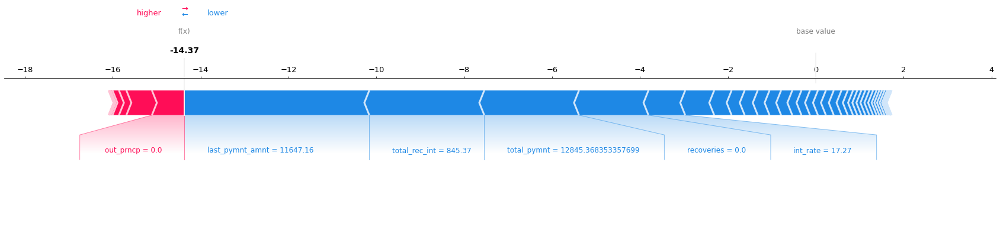

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 5)).savefig('xgbRAPIDS_Optuna_US_300_GPU_f1weighted_ShapForcePlot_TrainSet.png', 
                                                     my_dpi=my_dpi*10, 
                                                     bbox_inches='tight');

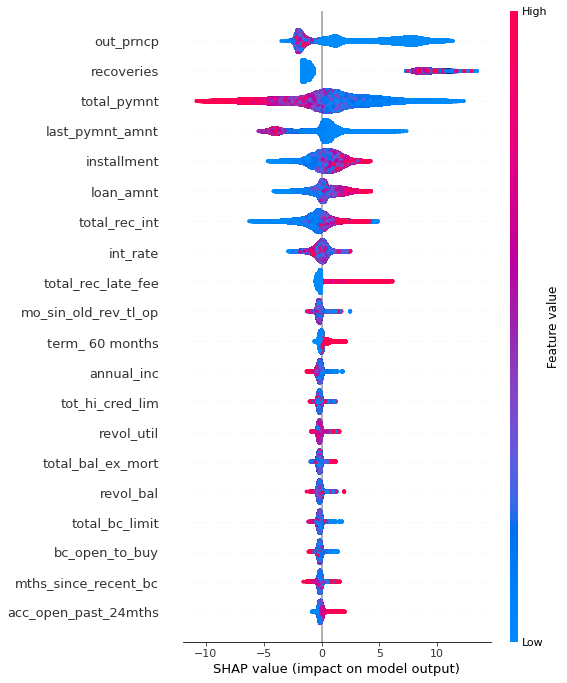

In [ ]:
# Training Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_train.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_US_300_GPU_f1weighted_ShapSummary_TrainSet.png', 
            my_dpi=my_dpi*10, bbox_inches='tight')

In [ ]:
# Test Set: Feature Importance Computed with SHAP Values
shap.initjs()
shap_values = explainer.shap_values(X_test)

<Figure size 432x288 with 0 Axes>

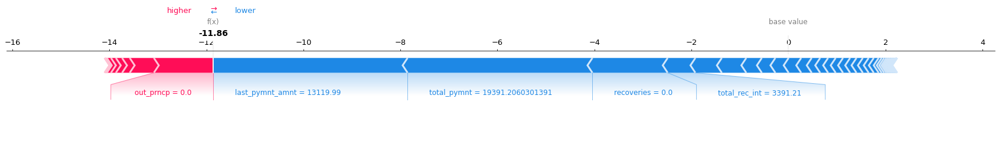

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 3)).savefig('xgbRAPIDS_Optuna_US_300_GPU_f1weighted_ShapForcePlot_TestSet.png', 
                                                     my_dpi=my_dpi*10, 
                                                     bbox_inches='tight');

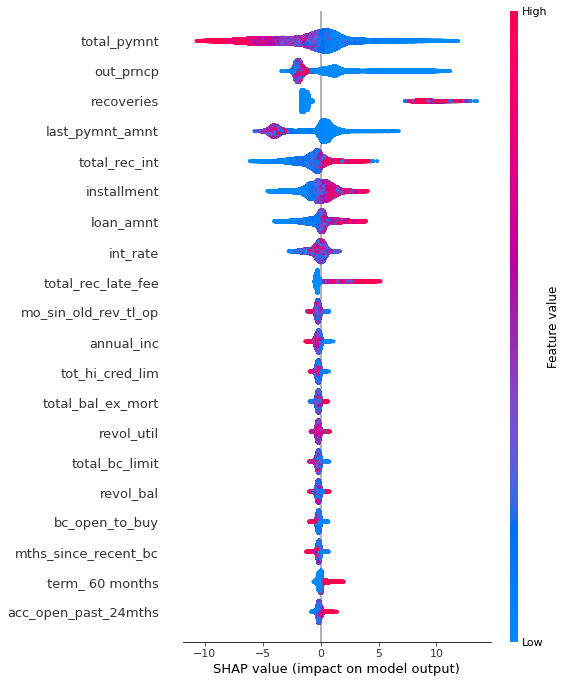

In [ ]:
# Test Set: Summarize the effects of all the features
fig = plt.figure()
plt.rcParams.update({'font.size': 7})
shap.summary_plot(shap_values, X_test.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_US_300_GPU_f1weighted_ShapSummary_TestSet.png', 
            my_dpi=my_dpi*10, bbox_inches='tight')

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

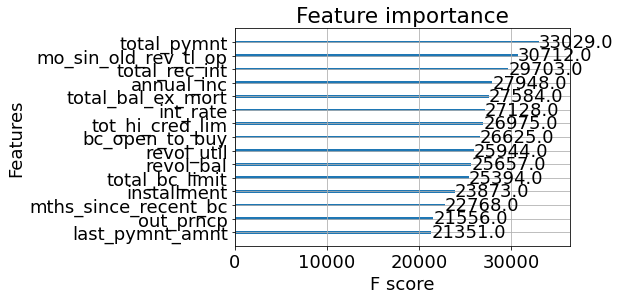

In [ ]:
# Feature importance
plot_importance(best_model, max_num_features=15);

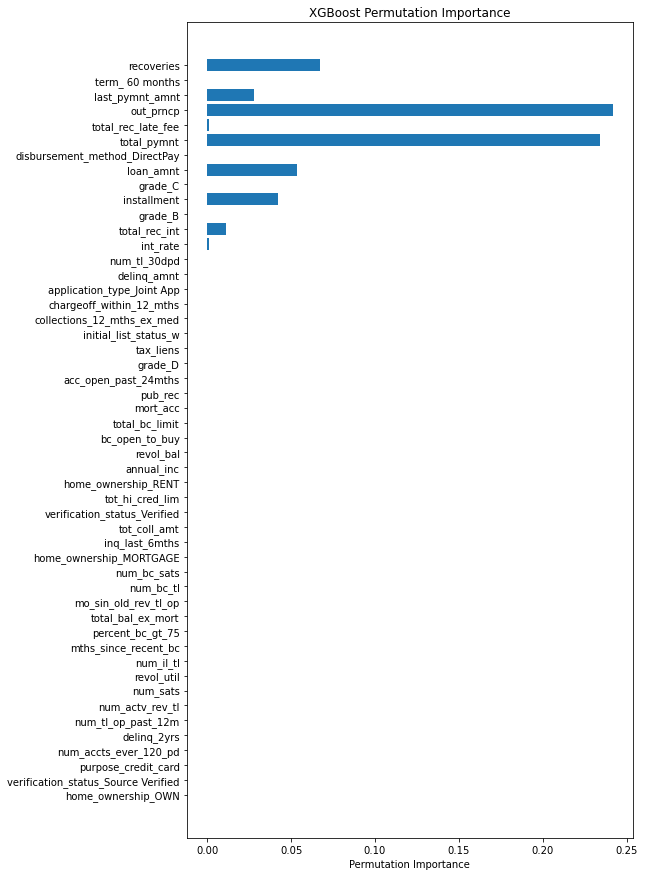

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()
plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('XGBoost Permutation Importance')
fig.savefig('xgbRAPIDS_Optuna_US_300_GPU_f1weighted_permImportance.png', 
            my_dpi=my_dpi*10, bbox_inches='tight');

## Weighted ROC

### 100 Trials

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL/

# Define a name for the trials
study_name = 'dask_optuna_US_xgbRapids_wROC_tpe'

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_us_xgb100gpu_trainvaltest_wROC', 
                'save_code': 'False', 'notes': 'us_xgb100gpu_trainvaltest_wROC'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 
  
    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'xgbRAPIDS_Optuna_US_100_GPU_ROCweighted.pkl')

    # Define parameter grid
    params_xgboost_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 100, 500),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'subsample': trial.suggest_float('subsample', 0.25, 0.75),
        'gamma': trial.suggest_float('gamma', 0, 3),
        'learning_rate': trial.suggest_float('learning_rate', 1e-4, 0.3),
        'reg_alpha': trial.suggest_float('reg_alpha', 0, 3),
        'reg_lambda': trial.suggest_float('reg_lambda', 0, 3),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.99),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.05, 0.5), 
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 10)
        }    

    # Define model type
    xgb = XGBClassifier(objective='binary:logistic',
                        booster='gbtree',
                        tree_method='gpu_hist',
                        scale_pos_weight=1,
                        use_label_encoder=False,
                        random_state=seed_value,
                        verbosity=0,
                        **params_xgboost_optuna)
    
    # Start timer for each trial
    start = timer()

    # Fit model
    xgb.fit(X_train, y_train, 
            eval_set=[(X_val, y_val)], 
            verbose=0)    
    
    # Predictions
    y_pred_val = xgb.predict(X_val)
    score = roc_auc_score(asnumpy(y_val), asnumpy(y_pred_val), 
                          average='weighted')
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial weighted ROC:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('xgbRAPIDS_Optuna_US_100_GPU_ROCweighted.pkl'): 
        study = joblib.load('xgbRAPIDS_Optuna_US_100_GPU_ROCweighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial),
                       n_trials=100)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest weighted ROC Score', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


- Trial time: 9.86788711301051
- Trial weighted ROC: 0.9601047032745421
######################################################
- Trial time: 7.206867807079107
- Trial weighted ROC: 0.9626090230823544
######################################################
- Trial time: 4.127752036089078
- Trial weighted ROC: 0.8705672074824178
######################################################
- Trial time: 5.3570842139888555
- Trial weighted ROC: 0.9584538103694575
######################################################
- Trial time: 6.317683847853914
- Trial weighted ROC: 0.9568376195190129
######################################################
- Trial time: 2.5824006218463182
- Trial weighted ROC: 0.954119948013822
######################################################
- Trial time: 5.617636944865808
- Trial weighted ROC: 0.9514461108491648
######################################################
- Trial time: 10.667181768920273
- Trial weighted ROC: 0.9743298289150409
##############################

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/trialOptions/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value':' roc_weighted'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('roc_weighted', ascending=False)
trials_df.to_csv('xgbRAPIDS_Optuna_US_100_GPU_ROCweighted.csv', index=False)
print(trials_df) 

    iteration  roc_weighted             datetime_start  \
91         91      0.996154 2022-09-17 20:05:38.704849   
97         97      0.996129 2022-09-17 20:08:22.555609   
86         86      0.996066 2022-09-17 20:03:44.338316   
73         73      0.996041 2022-09-17 19:58:44.163249   
84         84      0.996039 2022-09-17 20:03:02.993241   
..        ...           ...                        ...   
66         66      0.953456 2022-09-17 19:56:40.560860   
6           6      0.951446 2022-09-17 19:41:22.451164   
8           8      0.948554 2022-09-17 19:41:39.372759   
9           9      0.939644 2022-09-17 19:41:43.335911   
2           2      0.870567 2022-09-17 19:41:02.600612   

            datetime_complete               duration  colsample_bylevel  \
91 2022-09-17 20:06:07.437624 0 days 00:00:28.732775           0.483709   
97 2022-09-17 20:09:04.263776 0 days 00:00:41.708167           0.487094   
86 2022-09-17 20:04:10.826918 0 days 00:00:26.488602           0.476513   
73 

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_xgbRAPIDS_Optuna_US_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_xgbRAPIDS_Optuna_US_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_xgbRAPIDS_Optuna_US_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'learning_rate', 
                                                       'gamma'])
py.plot(fig, filename='contour_xgbRAPIDS_Optuna_US_100_GPU_ROCweighted.html')
fig.show()

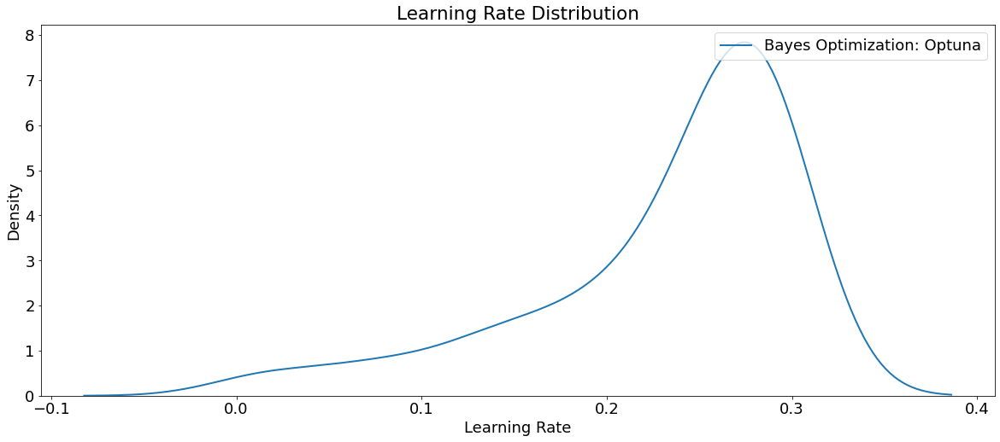

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

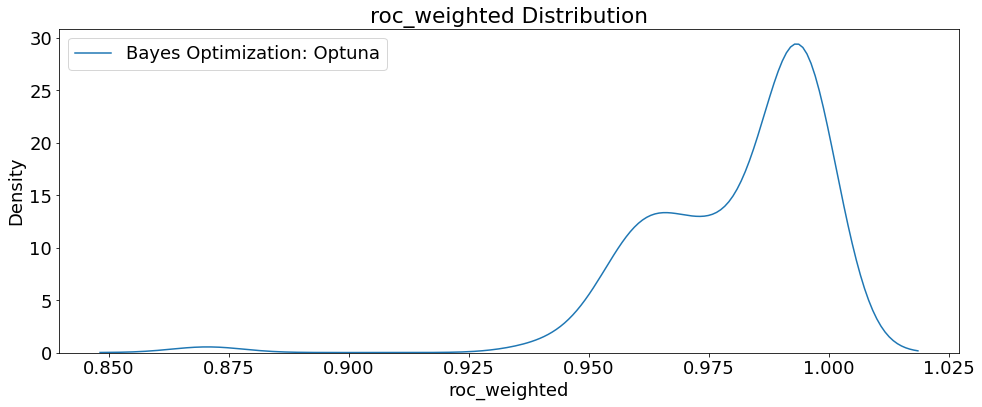

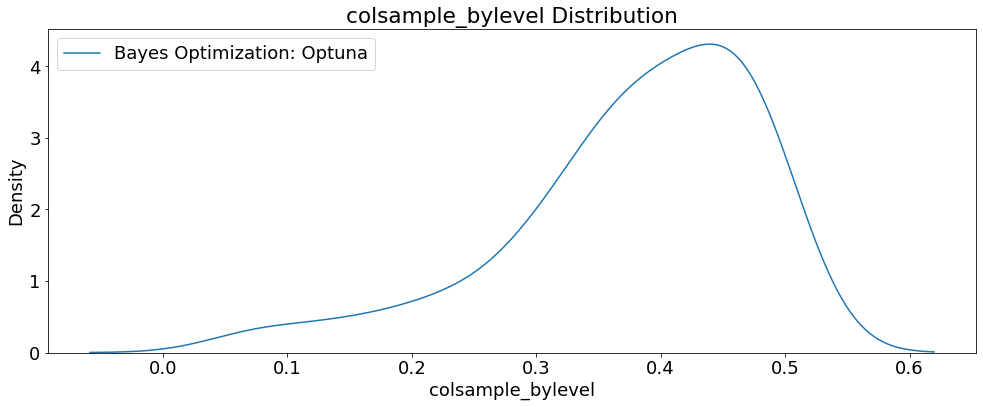

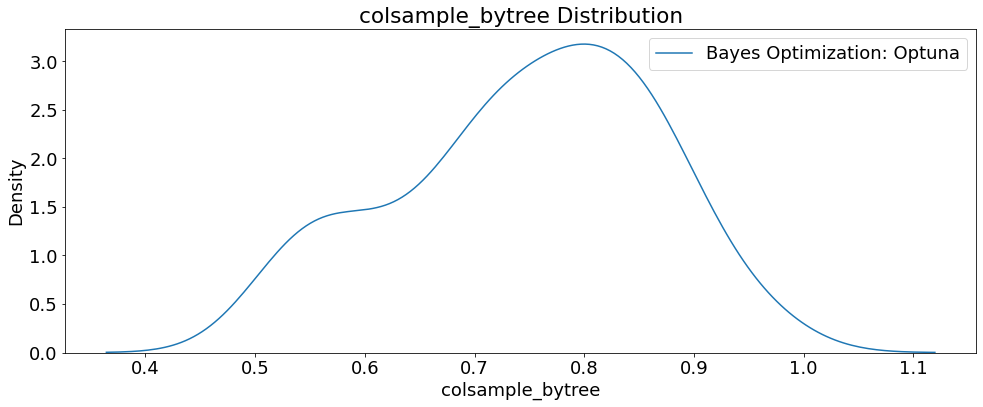

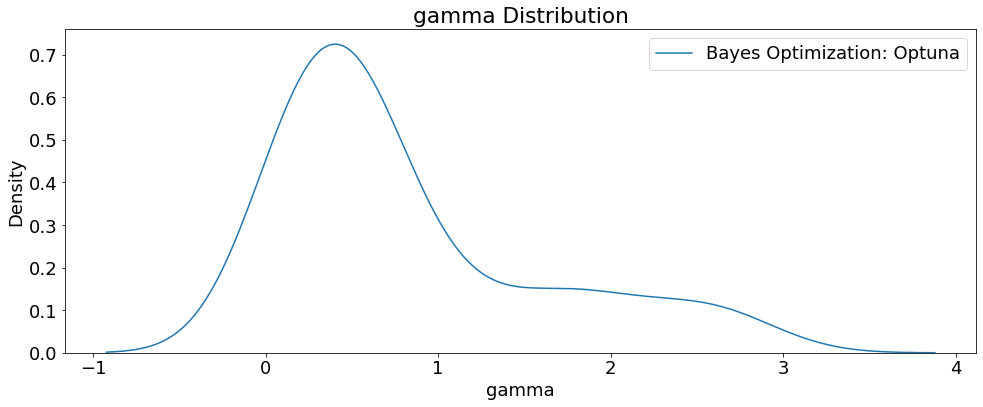

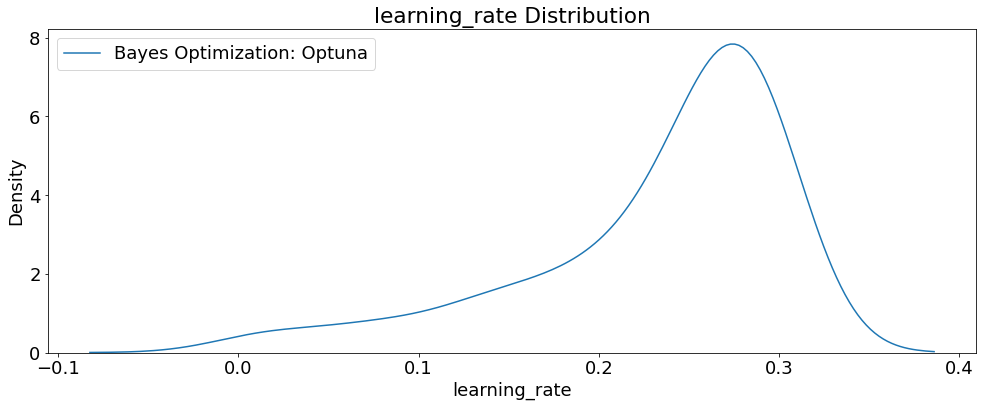

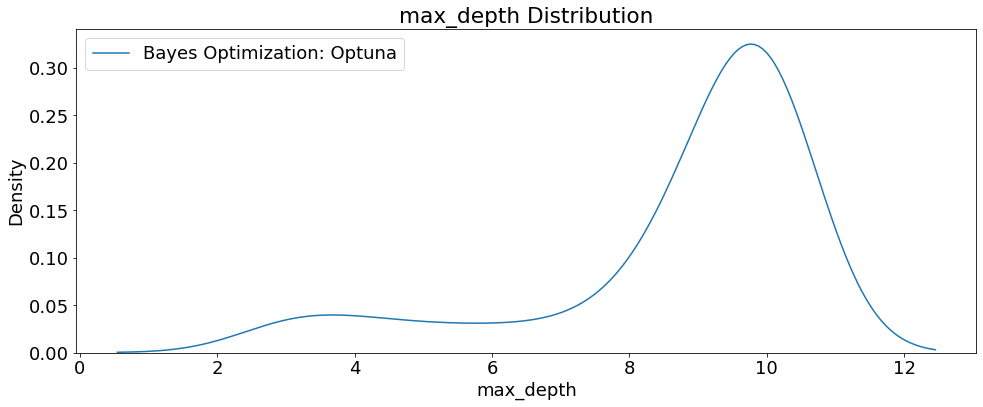

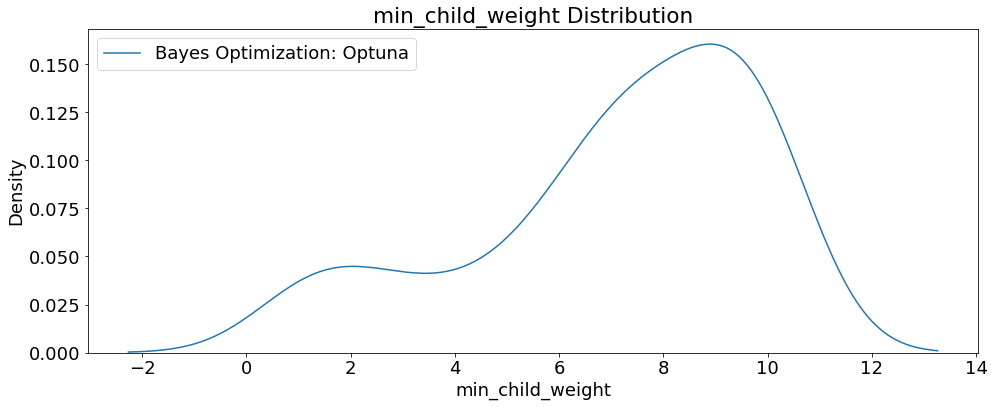

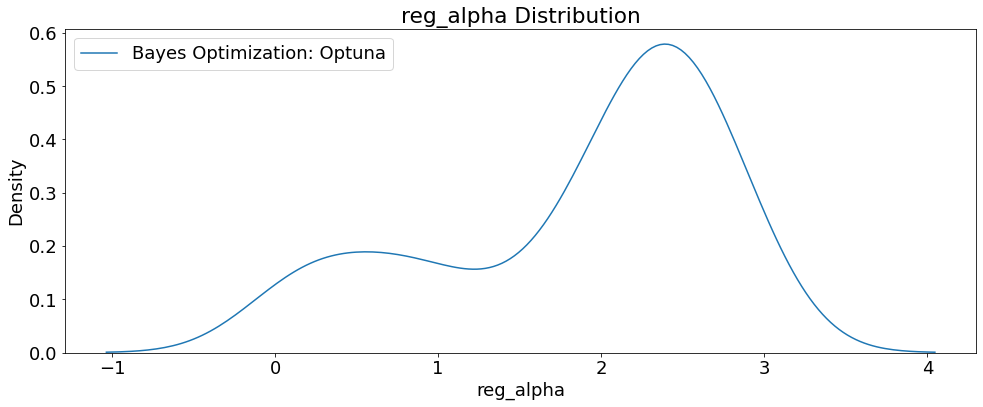

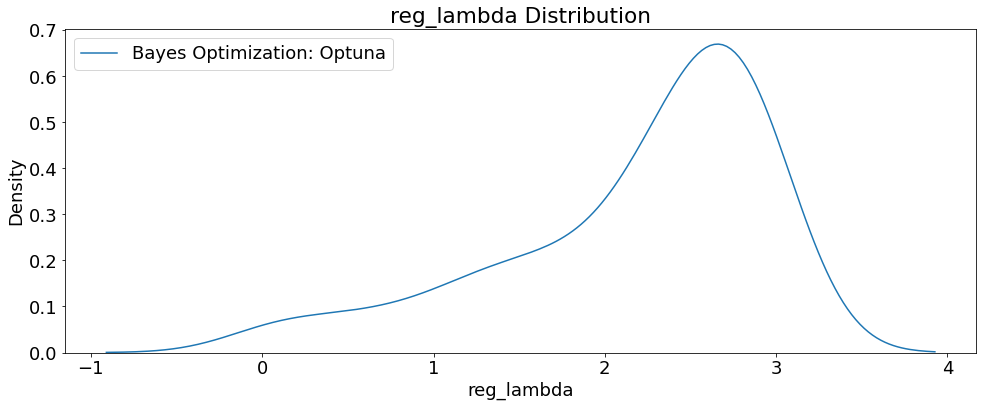

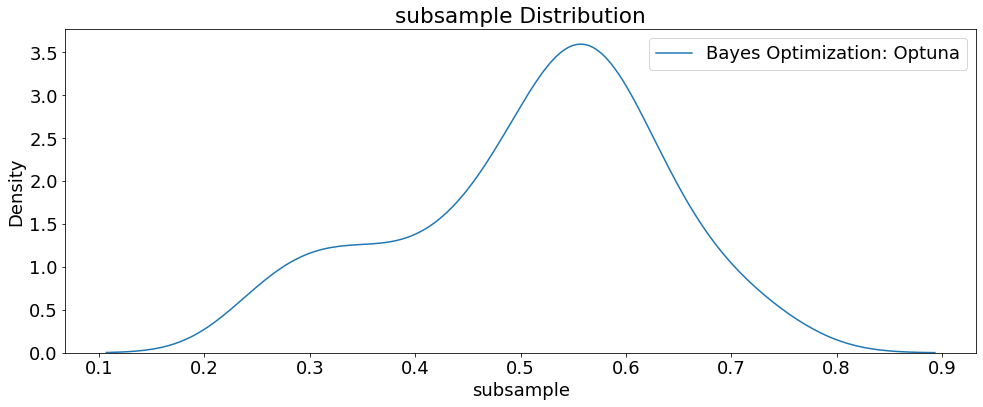

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

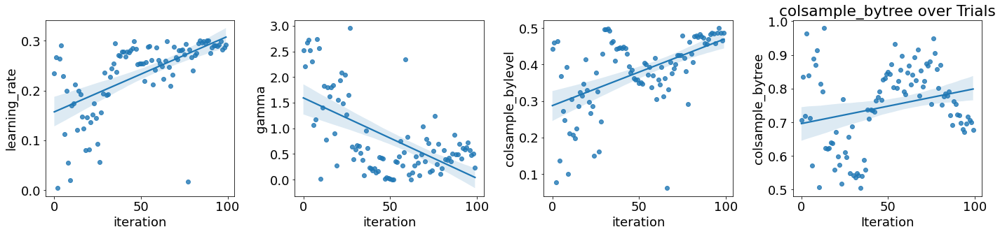

In [ ]:
# Plot quantitative hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'gamma', 'colsample_bylevel',
                         'colsample_bytree']): 
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

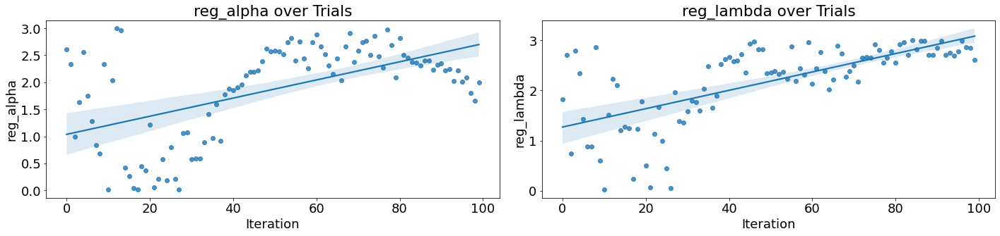

In [ ]:
# Scatterplot of regularization hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['reg_alpha', 'reg_lambda']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_xgbRAPIDS_Optuna_US_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_xgbRAPIDS_Optuna_US_100_GPU_ROCweighted.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params

{'n_estimators': 477,
 'max_depth': 10,
 'subsample': 0.5600531847640517,
 'gamma': 0.4045302646841799,
 'learning_rate': 0.2868540558126541,
 'reg_alpha': 2.2222982933817477,
 'reg_lambda': 2.98427402129868,
 'colsample_bytree': 0.7208013600465878,
 'colsample_bylevel': 0.4837090604373459,
 'min_child_weight': 7}

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_train = X_train.astype('float32')

X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = XGBClassifier(objective='binary:logistic', 
                           booster='gbtree',
                           tree_method='gpu_hist',
                           scale_pos_weight=1,
                           use_label_encoder=False,
                           random_state=seed_value,
                           verbosity=0,
                           **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'xgbRAPIDS_Optuna_US_100trials_GPU_ROCweighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('xgbRAPIDS_Optuna_US_100trials_GPU_ROCweighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost RAPIDS HPO Upsampling 100 trials GPU ROCweighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)
print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f' % accuracy_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Precision score : %.3f' % precision_score(asnumpy(y_test), 
                                                 asnumpy(y_test_pred)))
print('Recall score : %.3f' % recall_score(asnumpy(y_test), 
                                           asnumpy(y_test_pred)))
print('F1 score : %.3f' % f1_score(asnumpy(y_test), asnumpy(y_test_pred)))


Model Metrics for XGBoost RAPIDS HPO Upsampling 100 trials GPU ROCweighted


Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    377848
           1       0.98      0.92      0.95     54625

    accuracy                           0.99    432473
   macro avg       0.98      0.96      0.97    432473
weighted avg       0.99      0.99      0.99    432473



Confusion matrix:
[[376816   1032]
 [  4501  50124]]


Accuracy score : 0.987
Precision score : 0.980
Recall score : 0.918
F1 score : 0.948


In [ ]:
# Evaluate on the testing data 
print('The best model from Upsampling 100 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                               asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from Upsampling 100 GPU trials optimization scores 0.95744 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                    91
roc_weighted                           0.996154
datetime_start       2022-09-17 20:05:38.704849
datetime_complete    2022-09-17 20:06:07.437624
duration                 0 days 00:00:28.732775
colsample_bylevel                      0.483709
colsample_bytree                       0.720801
gamma                                   0.40453
learning_rate                          0.286854
max_depth                                    10
min_child_weight                              7
n_estimators                                477
reg_alpha                              2.222298
reg_lambda                             2.984274
subsample                              0.560053
state                                  COMPLETE
Name: 91, dtype: object


In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(asnumpy(X_test), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/xgbRAPIDS_Optuna_US_100_GPU_ROCweighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/xgbRAPIDS_Optuna_US_100_GPU_ROCweighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.2815 ± 0.0009,total_pymnt
0.2390 ± 0.0010,out_prncp
0.0867 ± 0.0004,loan_amnt
0.0764 ± 0.0006,installment
0.0671 ± 0.0002,recoveries
0.0409 ± 0.0004,last_pymnt_amnt
0.0266 ± 0.0002,total_rec_int
0.0070 ± 0.0003,int_rate
0.0020 ± 0.0001,total_rec_late_fee
0.0008 ± 0.0000,grade_D


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_test.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('xgbRAPIDS_Optuna_US_100_GPU_ROCweighted_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,total_pymnt,0.281531,0.000472
1,out_prncp,0.239008,0.000494
2,loan_amnt,0.086693,0.000177
3,installment,0.076419,0.000281
4,recoveries,0.067062,0.000095
5,last_pymnt_amnt,0.040872,0.000197
6,total_rec_int,0.026618,0.000096
7,int_rate,0.007029,0.000129
8,total_rec_late_fee,0.002009,0.000034
9,grade_D,0.000849,0.000024


In [ ]:
# Training Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_train)

<Figure size 432x288 with 0 Axes>

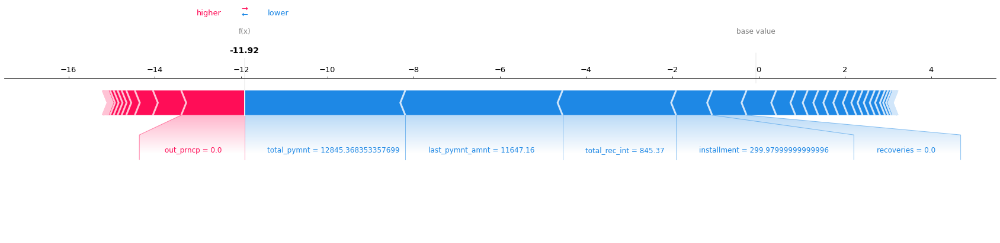

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 5)).savefig('xgbRAPIDS_Optuna_US_100_GPU_ROCweighted_ShapForcePlot_TrainSet.png', 
                                                                      my_dpi=my_dpi*10, 
                                                                      bbox_inches='tight');

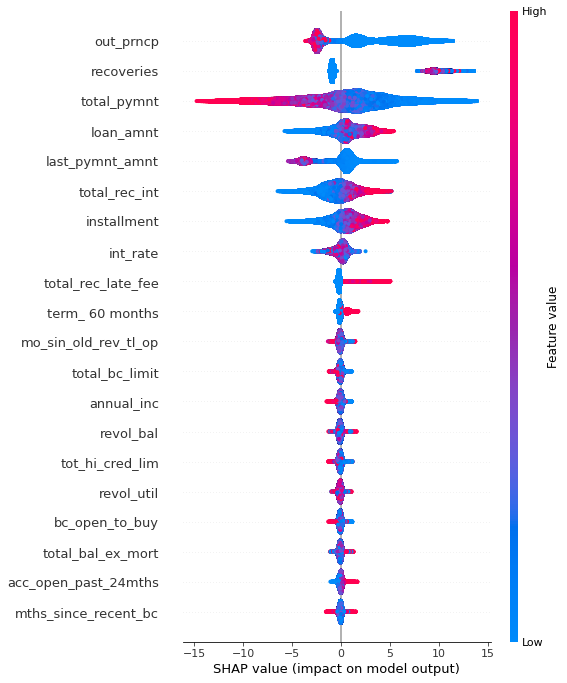

In [ ]:
# Training Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_train.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_US_100_GPU_ROCweighted_ShapSummary_TrainSet.png', 
            my_dpi=my_dpi*10, bbox_inches='tight');

In [ ]:
# Test Set: Feature Importance Computed with SHAP Values
shap.initjs()
shap_values = explainer.shap_values(X_test)

<Figure size 432x288 with 0 Axes>

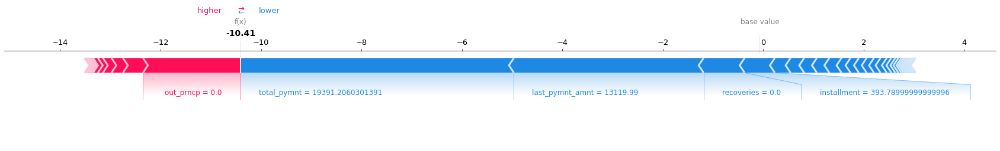

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 3)).savefig('xgbRAPIDS_Optuna_US_100_GPU_ROCweighted_ShapForcePlot_TestSet.png', 
                                                                      my_dpi=my_dpi*10, 
                                                                      bbox_inches='tight');

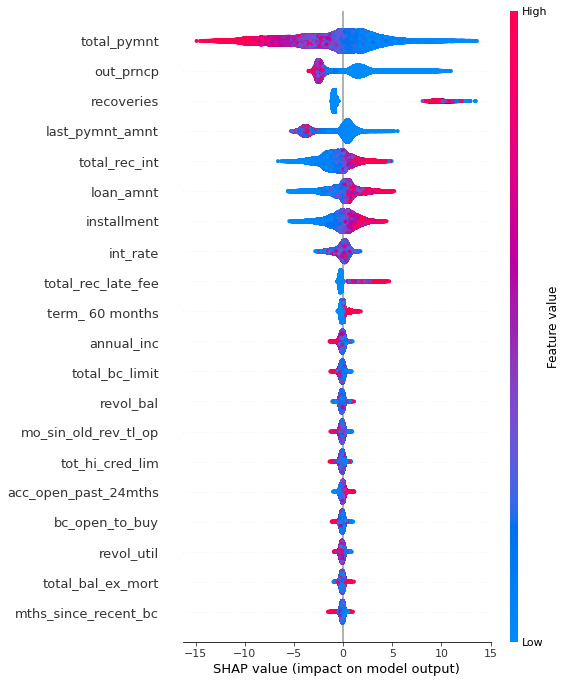

In [ ]:
# Test Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_test.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_US_100_GPU_ROCweighted_ShapSummary_TestSet.png', 
            my_dpi=my_dpi*10, bbox_inches='tight');

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

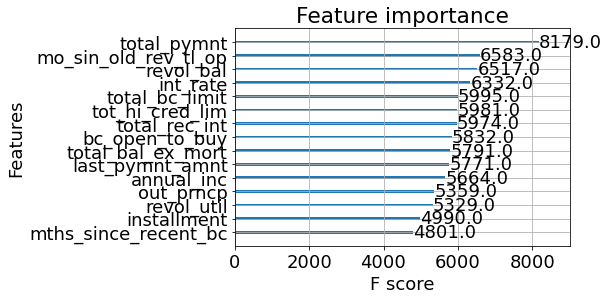

In [ ]:
# Feature importance
plot_importance(best_model, max_num_features=15);

<Figure size 432x288 with 0 Axes>

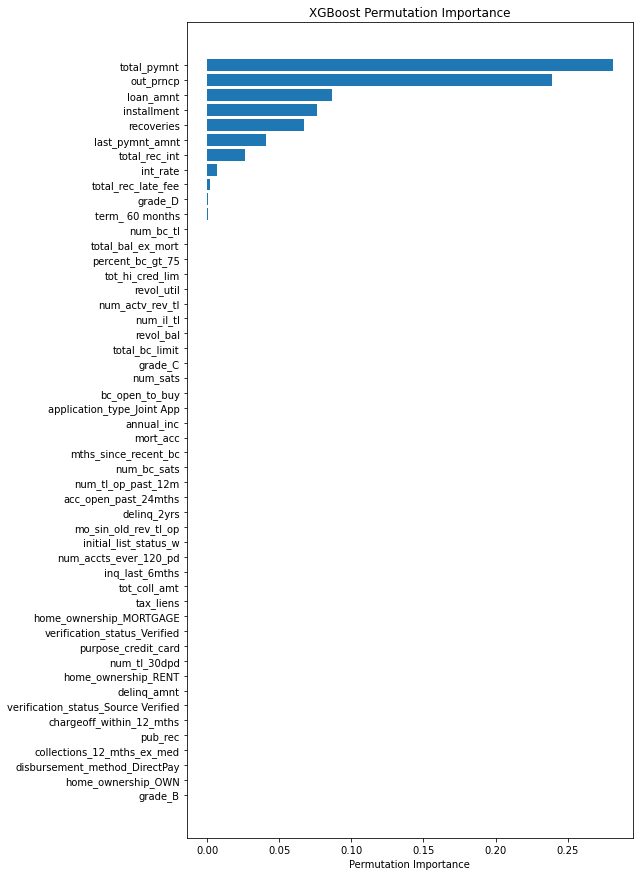

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()
plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('XGBoost Permutation Importance')
fig.savefig('xgbRAPIDS_Optuna_US_100_GPU_ROCweighted_permImportance.png', 
            my_dpi=my_dpi*10, bbox_inches='tight');

### 300 Trials

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL/

# Define a name for the trials
study_name = 'dask_optuna_US_xgbRapids_wROC_300_tpe'

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'loanStatus_hpo', 'entity': 'aschultz', 
                'group': 'optuna_us_xgb300gpu_trainvaltest_wROC', 
                'save_code': 'False', 'notes': 'us_xgb300gpu_trainvaltest_wROC'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial): 

    """
    Objective function to tune a `XGBoostClassifier` model.
    """
    joblib.dump(study, 'xgbRAPIDS_Optuna_US_300_GPU_ROCweighted.pkl')

    # Define parameter grid
    params_xgboost_optuna = {
        'n_estimators': trial.suggest_int('n_estimators', 400, 700),
        'max_depth': trial.suggest_int('max_depth', 8, 15),
        'subsample': trial.suggest_float('subsample', 0.4, 0.7),
        'gamma': trial.suggest_float('gamma', 1e-3, 1.3),
        'learning_rate': trial.suggest_float('learning_rate', 0.13, 0.3),
        'reg_alpha': trial.suggest_float('reg_alpha', 1.7, 3),
        'reg_lambda': trial.suggest_float('reg_lambda', 2, 3),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.6, 0.95),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.3, 0.6), 
        'min_child_weight': trial.suggest_int('min_child_weight', 6, 13)
        }  

    # Define model type
    xgb = XGBClassifier(objective='binary:logistic',
                        booster='gbtree',
                        tree_method='gpu_hist',
                        scale_pos_weight=1,
                        use_label_encoder=False,
                        random_state=seed_value,
                        verbosity=0,
                        **params_xgboost_optuna)
    
    # Start timer for each trial
    start = timer()

    # Fit model
    xgb.fit(X_train, y_train, 
            eval_set=[(X_val, y_val)], 
            verbose=0)    
    
    # Predictions
    y_pred_val = xgb.predict(X_val)
    score = roc_auc_score(asnumpy(y_val), asnumpy(y_pred_val), 
                          average='weighted')
        
    run_time = timer() - start
    print('- Trial time:', run_time) 
    print('- Trial weighted ROC:', score)
    print('######################################################')

    return score

In [ ]:
with timed('dask_optuna'):
    # Begin HPO trials 
    # Start timer for experiment
    search_time_start = time.time()
    if os.path.isfile('xgbRAPIDS_Optuna_US_300_GPU_ROCweighted.pkl'): 
        study = joblib.load('xgbRAPIDS_Optuna_US_300_GPU_ROCweighted.pkl')
    else: 
        study = optuna.create_study(sampler=optuna.samplers.TPESampler(), 
                                    study_name=study_name,
                                    direction='maximize')

    # Optimize in parallel on Dask cluster
    with parallel_backend('dask'):
        study.optimize(lambda trial: objective(trial),
                       n_trials=300)

# End timer for experiment
print('Time to run HPO:', time.time() - search_time_start)
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Highest weighted ROC Score', study.best_value)
wandb.finish()

- Trial time: 18.94962231302634
- Trial weighted ROC: 0.9951265073712299
######################################################
- Trial time: 29.411910795839503
- Trial weighted ROC: 0.9998245291414825
######################################################
- Trial time: 43.98280253005214
- Trial weighted ROC: 0.9999287908378083
######################################################
- Trial time: 28.842146700946614
- Trial weighted ROC: 0.9997401373034267
######################################################
- Trial time: 21.200252516195178
- Trial weighted ROC: 0.983382483716442
######################################################
- Trial time: 23.332171936053783
- Trial weighted ROC: 0.9917362284157737
######################################################
- Trial time: 32.32000293303281
- Trial weighted ROC: 0.999847703845317
######################################################
- Trial time: 43.441330862930045
- Trial weighted ROC: 0.9998195759516239
############################

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/trialOptions/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/trialOptions/


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value':' roc_weighted'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)

# Write processed data to csv
trials_df = trials_df.sort_values('roc_weighted', ascending=False)
trials_df.to_csv('xgbRAPIDS_Optuna_US_300_GPU_ROCweighted.csv', index=False)
print(trials_df) 

     iteration  roc_weighted             datetime_start  \
299        299      1.000000 2022-09-19 22:11:14.977368   
140        140      1.000000 2022-09-19 20:04:55.290437   
234        234      1.000000 2022-09-19 21:19:59.323532   
131        131      1.000000 2022-09-19 19:57:23.811586   
132        132      1.000000 2022-09-19 19:58:20.766136   
..         ...           ...                        ...   
13          13      0.996400 2022-09-19 18:32:17.619951   
19          19      0.995194 2022-09-19 18:35:32.446089   
0            0      0.995127 2022-09-19 18:24:17.079322   
5            5      0.991736 2022-09-19 18:26:46.932801   
4            4      0.983382 2022-09-19 18:26:25.266427   

             datetime_complete               duration  colsample_bylevel  \
299 2022-09-19 22:12:00.208607 0 days 00:00:45.231239           0.592397   
140 2022-09-19 20:05:45.992011 0 days 00:00:50.701574           0.571985   
234 2022-09-19 21:20:50.552373 0 days 00:00:51.228841          

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_xgbRAPIDS_Optuna_US_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_xgbRAPIDS_Optuna_US_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_xgbRAPIDS_Optuna_US_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart. 
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth', 
                                                       'learning_rate', 
                                                       'gamma'])
py.plot(fig, filename='contour_xgbRAPIDS_Optuna_US_300_GPU_ROCweighted.html')
fig.show()

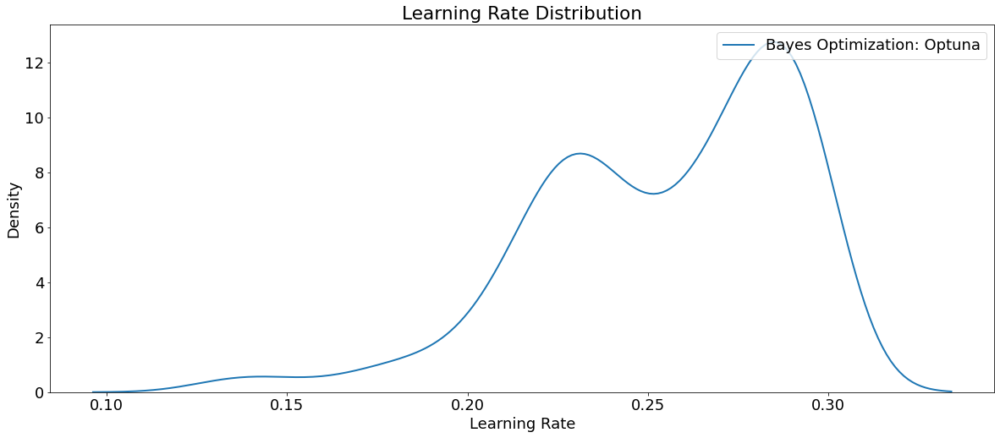

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); plt.title('Learning Rate Distribution');
plt.show()

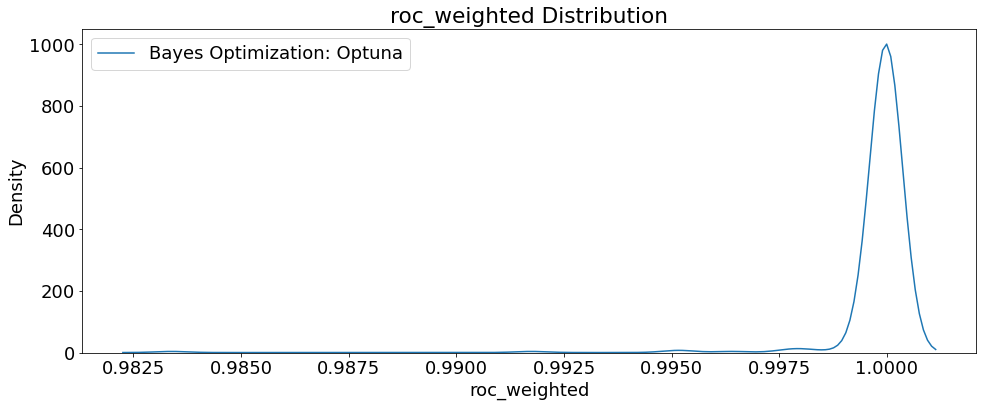

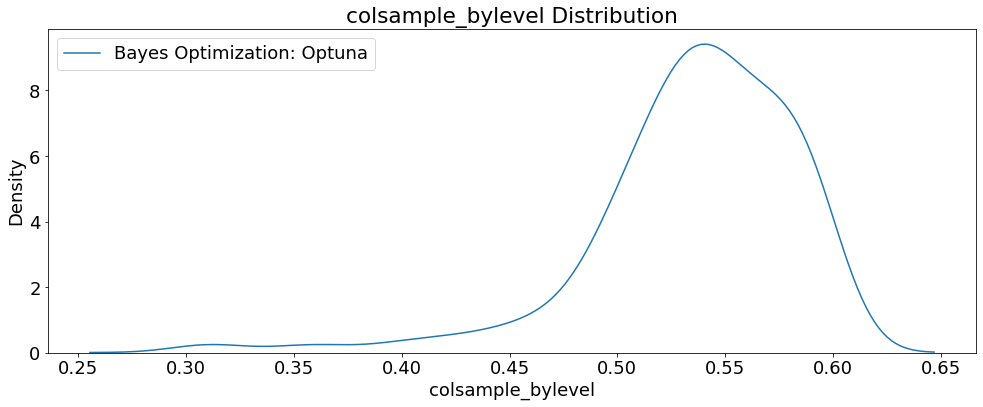

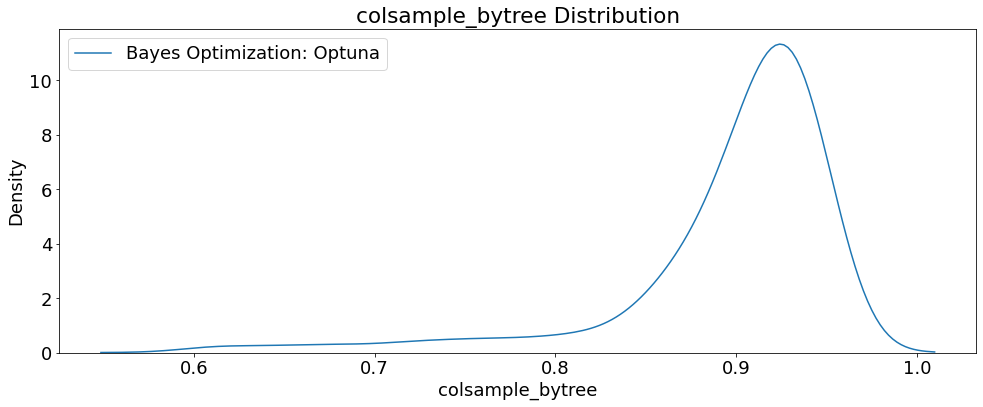

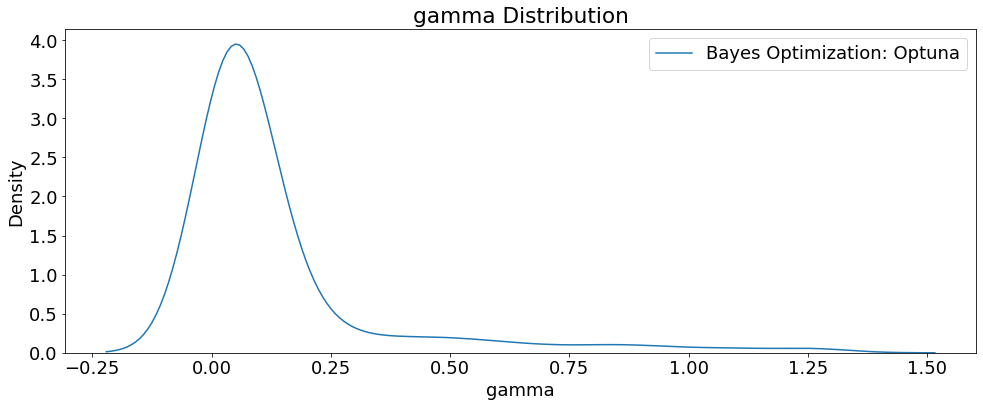

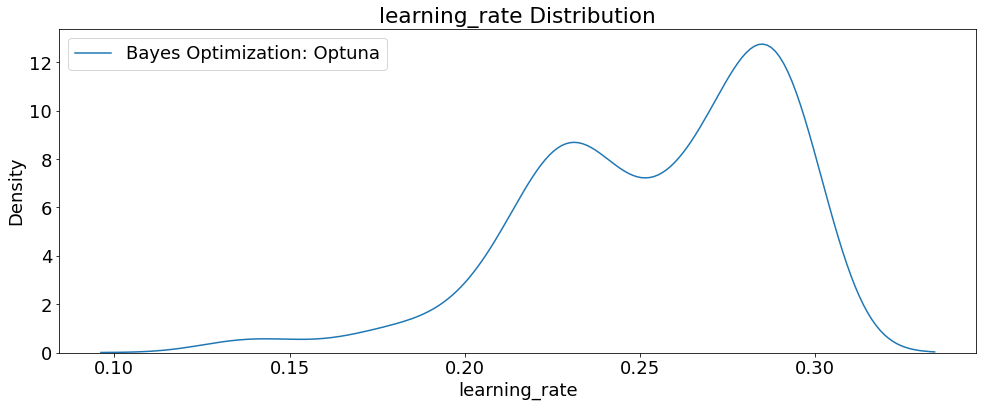

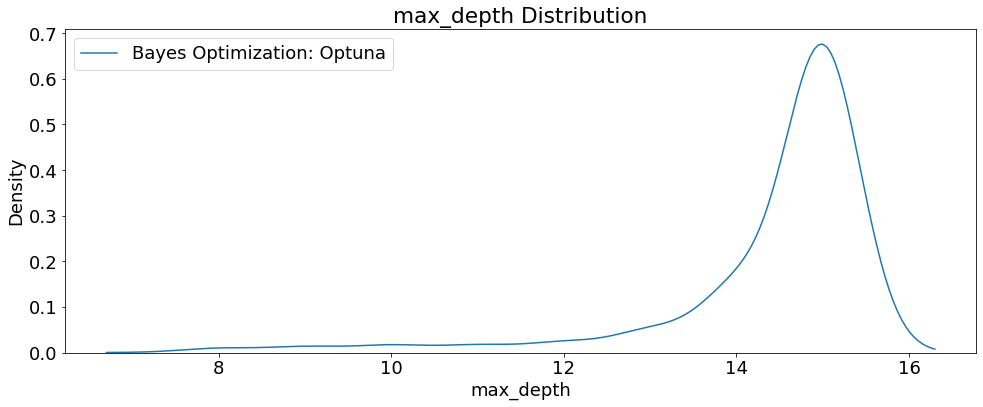

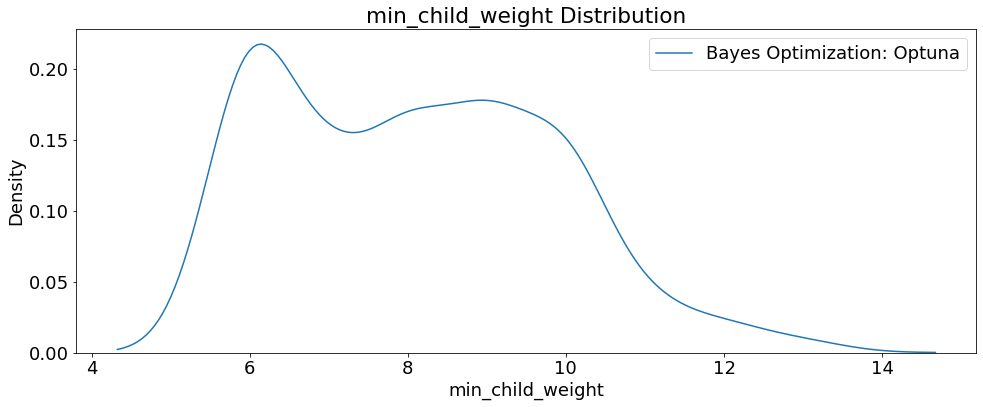

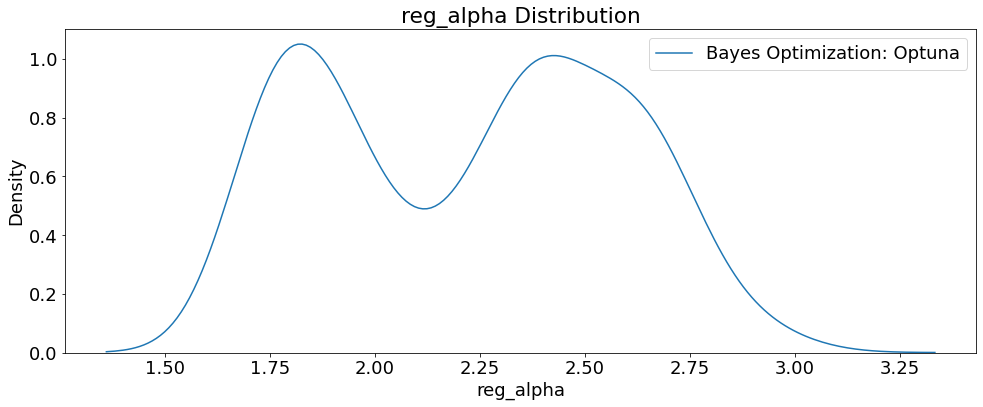

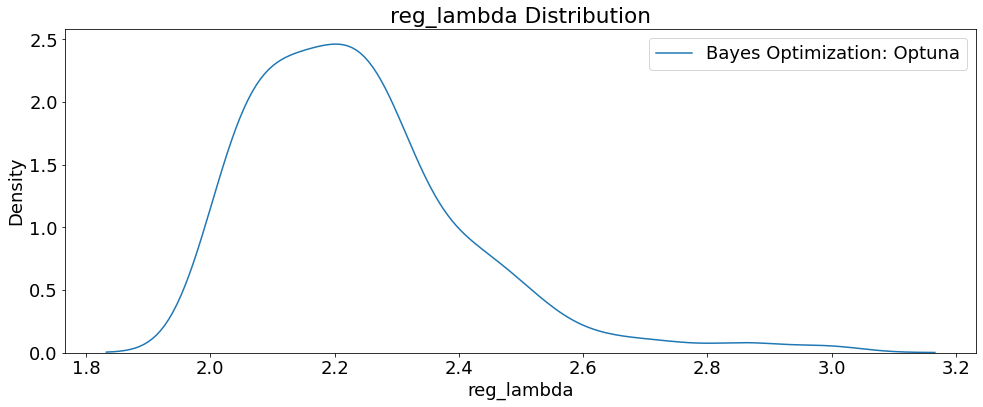

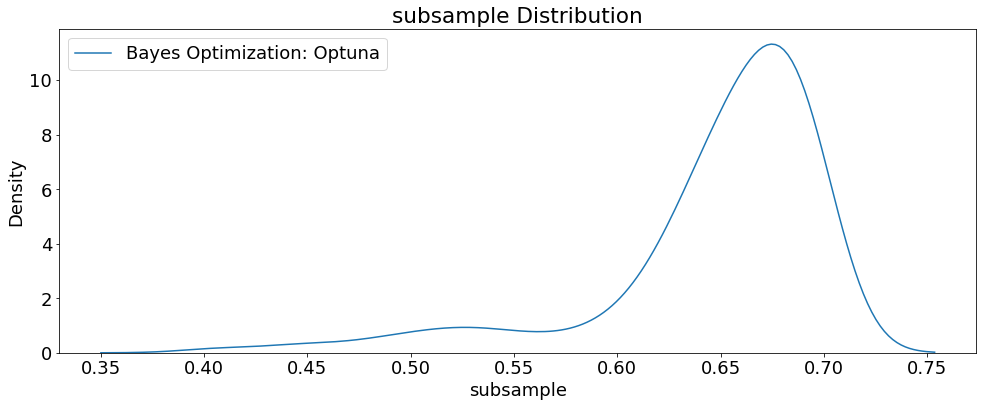

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'datetime_start', 'datetime_complete',
                   'duration','n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

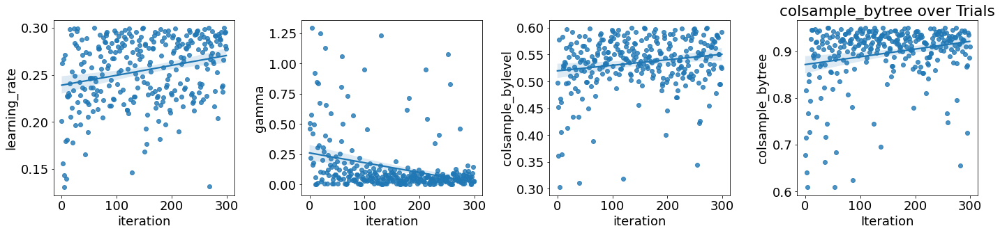

In [ ]:
# Plot quantitative hyperparameters
fig, axs = plt.subplots(1, 4, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'gamma', 'colsample_bylevel',
                         'colsample_bytree']): 
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

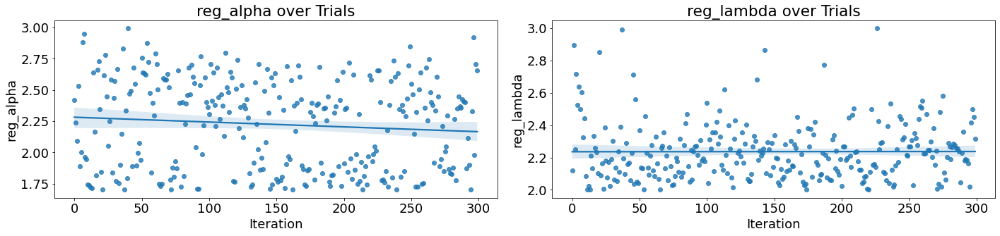

In [ ]:
# Scatterplot of regularization hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['reg_alpha', 'reg_lambda']):
  # Scatterplot
  sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
  axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
             title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_xgbRAPIDS_Optuna_US_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_xgbRAPIDS_Optuna_US_300_GPU_ROCweighted.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params

{'n_estimators': 679,
 'max_depth': 15,
 'subsample': 0.6947221166969779,
 'gamma': 0.0014367643574792477,
 'learning_rate': 0.22757896578272108,
 'reg_alpha': 1.7394615731204617,
 'reg_lambda': 2.0855392624782247,
 'colsample_bytree': 0.9268987727925864,
 'colsample_bylevel': 0.5302538632230461,
 'min_child_weight': 6}

In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_PKL


In [ ]:
# Set up train/test split
X_train, y_train = trainDF.drop('loan_status', axis=1), trainDF['loan_status'].astype('int32')
X_train = X_train.astype('float32')

X_test, y_test = testDF.drop('loan_status', axis=1), testDF['loan_status'].astype('int32')
X_test = X_test.astype('float32')

In [ ]:
# Re-create the best model and train on the training data
best_model = XGBClassifier(objective='binary:logistic', 
                           booster='gbtree',
                           tree_method='gpu_hist',
                           scale_pos_weight=1,
                           use_label_encoder=False,
                           random_state=seed_value,
                           verbosity=0,
                           **params)

# Fit the model
best_model.fit(X_train, y_train)

# Save model
Pkl_Filename = 'xgbRAPIDS_Optuna_US_300trials_GPU_ROCweighted.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('xgbRAPIDS_Optuna_US_300trials_GPU_ROCweighted.pkl')
# print(model)
# =============================================================================

In [ ]:
print('\nModel Metrics for XGBoost RAPIDS HPO Upsampling 300 trials GPU ROCweighted')
# Predict based on training 
y_train_pred = best_model.predict(X_train)
y_test_pred = best_model.predict(X_test)
print('\n')
print('Classification Report:')
clf_rpt = classification_report(asnumpy(y_test), asnumpy(y_test_pred))
print(clf_rpt)
print('\n')
print('Confusion matrix:')
print(confusion_matrix(asnumpy(y_test), asnumpy(y_test_pred)))
print('\n')
print('Accuracy score : %.3f' % accuracy_score(asnumpy(y_test), 
                                               asnumpy(y_test_pred)))
print('Precision score : %.3f' % precision_score(asnumpy(y_test), 
                                                 asnumpy(y_test_pred)))
print('Recall score : %.3f' % recall_score(asnumpy(y_test), 
                                           asnumpy(y_test_pred)))
print('F1 score : %.3f' % f1_score(asnumpy(y_test), 
                                   asnumpy(y_test_pred)))


Model Metrics for XGBoost RAPIDS HPO Upsampling 300 trials GPU ROCweighted


Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99    377848
           1       0.99      0.92      0.95     54625

    accuracy                           0.99    432473
   macro avg       0.99      0.96      0.97    432473
weighted avg       0.99      0.99      0.99    432473



Confusion matrix:
[[377326    522]
 [  4624  50001]]


Accuracy score : 0.988
Precision score : 0.990
Recall score : 0.915
F1 score : 0.951


In [ ]:
# Evaluate on the testing data 
print('The best model from Upsampling 300 GPU trials optimization scores {:.5f} AUC ROC on the test set.'.format(roc_auc_score(asnumpy(y_test), 
                                                                                                                               asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from Upsampling 300 GPU trials optimization scores 0.95698 AUC ROC on the test set.
This was achieved using these conditions:
iteration                                   299
roc_weighted                                1.0
datetime_start       2022-09-19 22:11:14.977368
datetime_complete    2022-09-19 22:12:00.208607
duration                 0 days 00:00:45.231239
colsample_bylevel                      0.592397
colsample_bytree                       0.910541
gamma                                  0.024682
learning_rate                          0.277507
max_depth                                    14
min_child_weight                              7
n_estimators                                560
reg_alpha                              2.658115
reg_lambda                             2.316168
subsample                              0.627566
state                                  COMPLETE
Name: 0, dtype: object


In [ ]:
%cd /notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/

/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations


In [ ]:
# Model metrics with Eli5
# Compute permutation feature importance
perm_importance = PermutationImportance(best_model,
                                        random_state=seed_value).fit(asnumpy(X_test), 
                                                                     asnumpy(y_test))
# Get the weights
# Store feature weights in an object
html_obj = eli5.show_weights(perm_importance,
                             feature_names=X_test.columns.tolist())

# Write feature weights html object to a file 
with open(r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/xgbRAPIDS_Optuna_US_300_GPU_ROCweighted_WeightsFeatures.htm',
          'wb') as f:
    f.write(html_obj.data.encode('UTF-8'))

# Open the stored feature weights HTML file
url = r'/notebooks/LoanStatus/Python/Models/ML/XGBoost/Optuna/TrainValTest/Model_Explanations/xgbRAPIDS_Optuna_US_300_GPU_ROCweighted_WeightsFeatures.htm'
webbrowser.open(url, new=2)

html_obj 

Weight,Feature
0.2516 ± 0.0007,total_pymnt
0.2409 ± 0.0009,out_prncp
0.0709 ± 0.0004,loan_amnt
0.0684 ± 0.0005,installment
0.0670 ± 0.0002,recoveries
0.0336 ± 0.0004,last_pymnt_amnt
0.0145 ± 0.0002,total_rec_int
0.0034 ± 0.0003,int_rate
0.0014 ± 0.0001,total_rec_late_fee
0.0002 ± 0.0000,term_ 60 months


In [ ]:
# Explain weights
explanation = eli5.explain_weights_sklearn(perm_importance, 
                                           feature_names=X_test.columns.tolist())
exp = format_as_dataframe(explanation)

# Write processed data to csv
exp.to_csv('xgbRAPIDS_Optuna_US_300_GPU_ROCweighted_WeightsExplain.csv',
           index=False)
exp

,feature,weight,std
0,total_pymnt,0.251568,0.000340
1,out_prncp,0.240856,0.000456
2,loan_amnt,0.070874,0.000207
3,installment,0.068356,0.000268
4,recoveries,0.066992,0.000085
5,last_pymnt_amnt,0.033624,0.000206
6,total_rec_int,0.014461,0.000080
7,int_rate,0.003350,0.000144
8,total_rec_late_fee,0.001380,0.000031
9,term_ 60 months,0.000213,0.000018


In [ ]:
# Training Set: Feature Importance Computed with SHAP Values
shap.initjs()
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_train)

<Figure size 432x288 with 0 Axes>

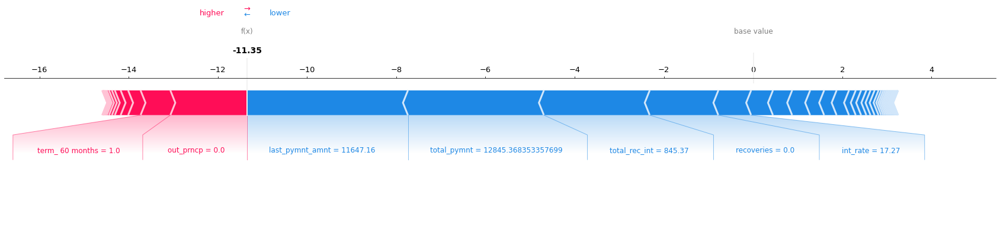

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], 
                X_train.iloc[0,:].to_pandas(), show=False, matplotlib=True, 
                figsize=(30, 5)).savefig('xgbRAPIDS_Optuna_US_300_GPU_ROCweighted_ShapForcePlot_TrainSet.png', 
                                         my_dpi=my_dpi*10, bbox_inches='tight');

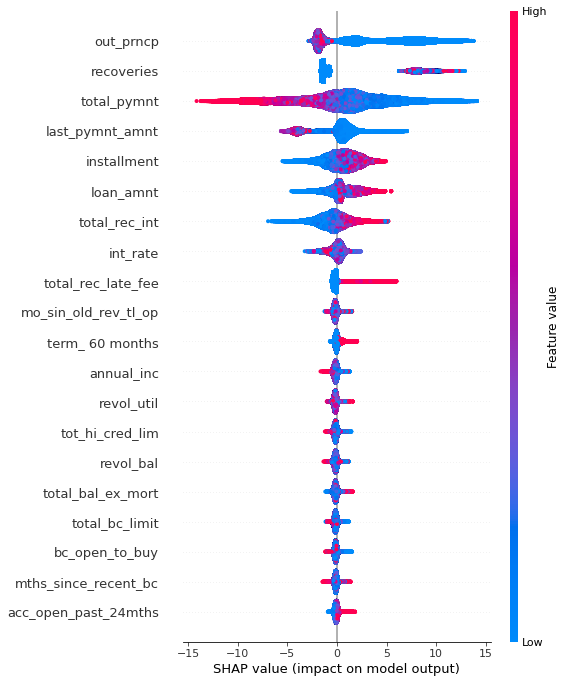

In [ ]:
# Training Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_train.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_US_300_GPU_ROCweighted_ShapSummary_TrainSet.png', 
            my_dpi=my_dpi*10, bbox_inches='tight');

In [ ]:
# Test Set: Feature Importance Computed with SHAP Values
shap.initjs()
shap_values = explainer.shap_values(X_test)

<Figure size 432x288 with 0 Axes>

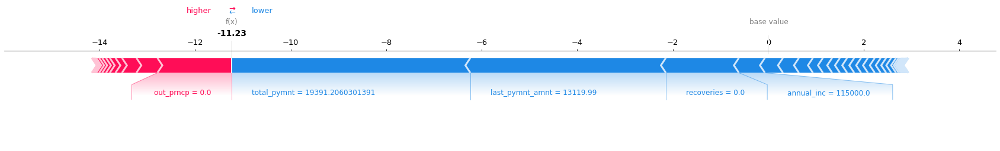

In [ ]:
# Visualize the first prediction's explanation
plt.rcParams.update({'font.size': 13})
fig = plt.figure()
shap.force_plot(explainer.expected_value, shap_values[0,:], X_test.iloc[0,:].to_pandas(), 
                show=False, matplotlib=True, figsize=(30, 3)).savefig('xgbRAPIDS_Optuna_US_300_GPU_ROCweighted_ShapForcePlot_TestSet.png', 
                                                                      my_dpi=my_dpi*10, 
                                                                      bbox_inches='tight');

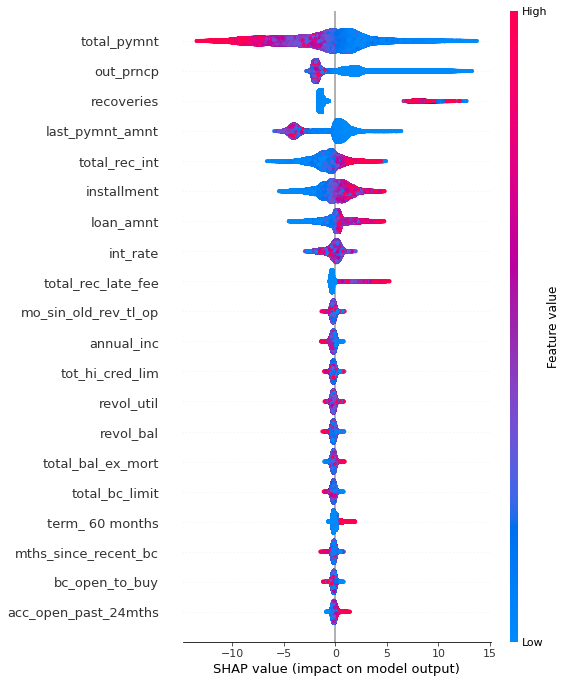

In [ ]:
# Test Set: Summarize the effects of all the features
plt.rcParams.update({'font.size': 7})
fig = plt.figure()
shap.summary_plot(shap_values, X_test.to_pandas(), show=False)
fig.savefig('xgbRAPIDS_Optuna_US_300_GPU_ROCweighted_ShapSummary_TestSet.png', 
            my_dpi=my_dpi*10, bbox_inches='tight');

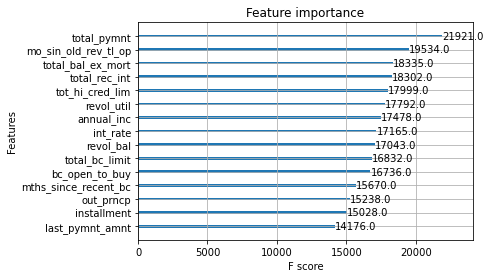

In [ ]:
# Feature importance
plot_importance(best_model, max_num_features=15);

<Figure size 432x288 with 0 Axes>

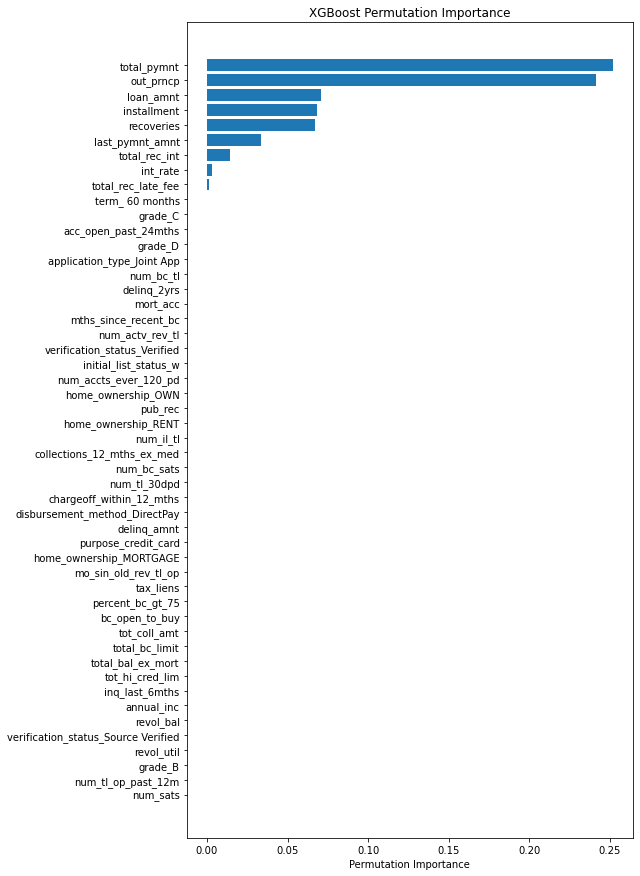

In [ ]:
# Permutation importance
perm_importance = permutation_importance(best_model, X_test.to_pandas(), 
                                         asnumpy(y_test))

sorted_idx = perm_importance.importances_mean.argsort()
fig = plt.figure()
plt.rcParams.update({'font.size': 10})
fig = plt.figure(figsize=(8, 15))
plt.barh(testDF.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel('Permutation Importance')
plt.title('XGBoost Permutation Importance')
fig.savefig('xgbRAPIDS_Optuna_US_300_GPU_ROCweighted_permImportance.png', 
            my_dpi=my_dpi*10, bbox_inches='tight');